In [9]:
from collections import defaultdict, Counter 
import colorsys
import itertools
import pickle 
import os

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

from scipy.spatial import distance, ConvexHull
from scipy.stats import spearmanr
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import KMeans
from sklearn.metrics import mutual_info_score, normalized_mutual_info_score
from sklearn.manifold import TSNE
import fcsparser 
from ete3 import Tree, TreeNode, TreeStyle, TextFace

data_dir = '.'

class TreeNodeHashable(TreeNode):
    def __init__(self, newick=None, format=0, dist=None, support=None,
                 name=None, quoted_node_names=False):
        super().__init__(newick, format, dist, support, name, quoted_node_names)
        self.coords = []
        self.cluster_id = 0
        
    def __eq__(self, other):
        return (self.name == other.name) and self.coords.equals(other.coords) and (self.cluster_id == other.cluster_id)
        
    def __hash__(self):
        return hash((self.name, str(self.coords), self.cluster_id))

In [10]:
supplementary_data = pd.read_csv('../Suppl.Table2.CODEX_paper_MRLdatasetexpression.csv')
supplementary_data = supplementary_data[['X.X', 'Y.Y', 'Z.Z', 'sample_Xtile_Ytile', 
                                         'CD45', 'Imaging phenotype cluster ID']]
supplementary_data.rename(columns={'X.X': 'X', 'Y.Y': 'Y', 'Z.Z': 'Z'}, inplace=True)
supplementary_data['CD45_int'] = supplementary_data['CD45'].astype(int)

def convert_coordinates(df, tile_length=1342, tile_width=1006):
    df['tile_x'] = df['sample_Xtile_Ytile'].apply(lambda x: int(x.split('_')[1][2])) - 1
    df['tile_y'] = df['sample_Xtile_Ytile'].apply(lambda x: int(x.split('_')[2][2])) - 1
    df['X'] = tile_length * df['tile_x'] + df['X']
    df['Y'] = tile_width * df['tile_y'] + df['Y']
    
    return df

def process_fcs(df):
    df.rename(columns={'F4': 'F480', 'CD16': 'CD1632', 'CD21': 'CD2135', 
                       'X.X': 'X', 'Y.Y': 'Y', 'Z.Z': 'Z'}, inplace=True)
    df['CD45_int'] = df['CD45'].astype(int)
    df = pd.merge(df, supplementary_data, on=['X', 'Y', 'Z', 'CD45_int'])
    df = convert_coordinates(df)
    df.drop(['CD45_int'], axis=1, inplace=True)
    
    return df

def get_clusters(sample_name):
    all_neighbors = list(reversed(range(5, 100+1)))
    nn_nums = []
    num_clusters = []
    for nn in all_neighbors:
        try:
            _, data = fcsparser.parse(data_dir + '/' + sample_name + '/' + str(nn) + '/out/' + sample_name + '.fcs') 
            clusters = len(np.unique(data['cluster_id']))
            num_clusters.append(clusters)
            nn_nums.append(nn)
        except:
            continue
    
    return num_clusters, nn_nums

def get_unique_clusters(sample_name):
    num_clusters, nn_nums = get_clusters(sample_name)
    dist_neighbors, dist_clusters = [], []
    for i in range(len(num_clusters)):
        if i > 0 and num_clusters[i] != num_clusters[i-1]:
            dist_neighbors.append(nn_nums[i])
            dist_clusters.append(num_clusters[i])
    
    return dist_clusters, dist_neighbors

In [11]:
def add_tree_layer(tree, leaves, clusters, proportions, child_coords, prop_filter):
    '''
    tree: tree that we want to add an additional layer to
    leaves: leaves of tree 
    clusters: number of clusters in the child layer
    proportions: nested dictionary containing id of parent and id of child and the proportion of cells 
                 contained in the parent that are also contained in the child 
    prop_filter: proportion of cells for edge between clusters to be created 
    '''
    child_nodes = {}
    for ind in range(len(clusters)):
        child_node_id = clusters[ind]
        child_nodes[child_node_id] = TreeNode(name=child_node_id)
        #child_nodes[child_node_id] = TreeNodeHashable(name=child_node_id)
        # add coordinate data to node 
        child_nodes[child_node_id].add_features(coords=child_coords[child_node_id]) 
        child_nodes[child_node_id].add_features(cluster_id=child_node_id)
    for parent_node_id, parent_node in leaves.items():
        for child_node_id, child_node in child_nodes.items():
            if proportions[parent_node_id][child_node_id] > prop_filter:
                parent_node.add_child(child_node)
                
    return tree, child_nodes
    
def build_tree(fcs_paths, num_neighbors, prop_filter=0.1):
    '''
    fcs_paths: dictionary of (cluster numbers, path)
    num_neighbors: number of neighbors used in X-shift 
    prop_filter: proportion of cells for edge between clusters to be created 
    '''
    # first initialize tree with 1 node at top and its children 
    tree = TreeNode(name=0)
    #tree = TreeNodeHashable(name=0)
    leaves = {0: tree}
    _, cluster_data_child = fcsparser.parse(fcs_paths[0])
    cluster_data_child = process_fcs(cluster_data_child)
    tree.add_features(coords=cluster_data_child[['X', 'Y', 'Z']])
    tree.add_features(cluster_id=0)
    child_cluster_counts = cluster_data_child['cluster_id'].value_counts()
    child_coords = cluster_data_child[['cluster_id', 'X', 'Y', 'Z']]
    child_coords_groupby = child_coords.groupby('cluster_id')
    child_coords = {group: child_coords.loc[inds, ['X', 'Y', 'Z']]
                    for group, inds in child_coords_groupby.groups.items()}
    clusters = list(child_cluster_counts.keys())
    child_cluster_counts /= child_cluster_counts.sum()
    proportions = {0 : child_cluster_counts.to_dict()}
    # set proportion filter to 0 for first layer, as everything is a child of the vertex
    tree, leaves = add_tree_layer(tree, leaves, clusters, proportions, child_coords, prop_filter=0)
    
    # build the rest of the tree 
    for ind, nn in enumerate(num_neighbors[:-1]):
        #print('Processing layer', nn)
        _, cluster_data_parent = fcsparser.parse(fcs_paths[ind])
        _, cluster_data_child = fcsparser.parse(fcs_paths[ind+1])
        cluster_data_parent = process_fcs(cluster_data_parent)
        cluster_data_child = process_fcs(cluster_data_child)
        
        child_cluster_counts = cluster_data_child['cluster_id'].value_counts()
        clusters = list(child_cluster_counts.keys())
        match_data_parent = cluster_data_parent[['X', 'Y', 'Z', 'cluster_id']].astype(int)
        match_data_child = cluster_data_child[['X', 'Y', 'Z', 'cluster_id']].astype(int)
        merged = pd.merge(match_data_parent, match_data_child, on=['X', 'Y', 'Z'])
        parent_clusters = merged['cluster_id_x'].tolist()
        child_clusters = merged['cluster_id_y'].tolist()
        child_coords = cluster_data_child[['cluster_id', 'X', 'Y', 'Z']]
        child_coords_groupby = child_coords.groupby('cluster_id')
        child_coords = {group: child_coords.loc[inds, ['X', 'Y', 'Z']]
                        for group, inds in child_coords_groupby.groups.items()}
        proportions = defaultdict(Counter)
        for parent_cluster, child_cluster in zip(parent_clusters, child_clusters):
            proportions[parent_cluster][child_cluster] += 1/child_cluster_counts[child_cluster]
        tree, leaves = add_tree_layer(tree, leaves, clusters, proportions, child_coords, prop_filter)
        
    return tree 

def probability_neighbor_same(data, cluster_num):
    '''
    Compute the probability that the nearest neighbors of 
    each cluster point are also the same cluster. 
    '''
    coords = data[['X', 'Y']].values
    clusters = data['cluster_id'].values
    cluster_ind = np.where(clusters == cluster_num)[0]
    nbrs_model = NearestNeighbors(n_neighbors = 1).fit(coords)
    _, indices = nbrs_model.kneighbors()
    prob = np.mean(clusters[indices[cluster_ind]] == cluster_num)
    
    return prob

def probability_neighbor_same_in_parent(node):
    '''
    Compute the probability that the nearest neigbor of 
    each child cluster point (with respect to the union of the child points
    and parent neighbors) is also in the cluster. 
    '''
    child_coords = node.coords[['X', 'Y']]
    child_coords['cluster'] = 'child'
    parent_coords = node.up.coords[['X', 'Y']]
    coords = pd.merge(child_coords, parent_coords, on=['X', 'Y'], how='outer')
    coords['cluster'] = coords['cluster'].apply(lambda x: 'child' if x == 'child' else 'parent')
    nbrs_model = NearestNeighbors(n_neighbors = 2).fit(coords[['X', 'Y']].values)
    _, indices = nbrs_model.kneighbors(child_coords[['X', 'Y']].values)
    nearest_in_parent = []
    coords_vals, child_coords_vals = coords[['X', 'Y']].values, child_coords[['X', 'Y']].values
    for ind, nearest_ind in enumerate(indices):
        if not np.array_equal(coords_vals[nearest_ind[0]], child_coords_vals[ind]):
            nearest_in_parent.append(nearest_ind[0])
        else:
            nearest_in_parent.append(nearest_ind[1])
    prob = np.mean(coords.loc[nearest_in_parent, 'cluster'] == 'child')
    
    return prob

def center_mass_shift(node):
    '''
    Compute the amount of change in the center of mass of the
    data in the current node from that of its parent. 
    '''
    center_child = node.coords[['X', 'Y']].mean()
    center_parent = node.up.coords[['X', 'Y']].mean()
    dist = np.sqrt((center_child['X'] - center_parent['X'])**2 + (center_child['Y'] - center_parent['Y'])**2)
    return dist 

def nearest_neighbor_prob_change(parent_data, child_data, layer):
    '''
    Using the hierarchical tree of clusters we create above, we compute the 
    difference of the average probability that the child cluster's closest neighbor 
    is in the same cluster, and the probability that the parent cluster's closest 
    neighbor is in the same cluster. 
    ''' 
    prob_change = 0
    for node in layer:
        if len(node.children) < 2:
            continue
        else:
            parent_prob = probability_neighbor_same(parent_data, node.cluster_id)
            child_prob = np.mean([probability_neighbor_same(child_data, child.cluster_id)
                                           for child in node.children if len(child.coords) > 2])
            prob_change += (child_prob - parent_prob)
    
    return prob_change 

def get_grid_counts(node, grid_size=25):
    '''
    Divide points into a grid, and get the count of the number of points
    in each grid cell in the child and parent. 
    '''
    x_max, y_max = node.coords['X'].max(), node.coords['Y'].max()
    x_length, y_length = x_max / grid_size, y_max / grid_size
    grid_coords = itertools.product(range(grid_size), range(grid_size))
    grid_x_child, grid_y_child = node.coords['X'] // x_length, node.coords['Y'] // y_length
    grid_child = Counter(zip(grid_x_child, grid_y_child))
    grid_x_parent, grid_y_parent = node.up.coords['X'] // x_length, node.up.coords['Y'] // y_length
    grid_parent = Counter(zip(grid_x_parent, grid_y_parent))
    grid_child_counts, grid_parent_counts = [], []
    for grid_coord_tuple in grid_coords:
        grid_child_counts.append(grid_child[grid_coord_tuple])
        grid_parent_counts.append(grid_parent[grid_coord_tuple])
        
    return grid_child_counts, grid_parent_counts

def spearman_corr_change(node, grid_size=25):
    '''
    Partition the image into a grid, and compute the fraction of cells in each cell of the grid. 
    We then compute the spearman correlation between the parent and child cluster using these values. 
    ''' 
    grid_child_counts, grid_parent_counts = get_grid_counts(node, grid_size)
    spearman_corr, _ = spearmanr(grid_child_counts, grid_parent_counts)
    
    return spearman_corr

def mutual_info_change(node, grid_size=25):
    '''
    Partition the image into a grid, and compute the fraction of cells in each cell of the grid. 
    We then compute the mutual information between the parent and child cluster using these values. 
    '''
    grid_child_counts, grid_parent_counts = get_grid_counts(node, grid_size)
    joint_histogram = np.histogram2d(grid_child_counts, grid_parent_counts, bins=grid_size**2)[0]
    score = mutual_info_score(None, None, contingency=joint_histogram)
    
    return score

def tree_probability_change(sample_name, fcs_paths, num_neighbors, num_clusters, tree):
    '''
    Perform a BFS through the tree, and calculate the difference in cluster probability 
    between each layer and the one below it. 
    '''
    layer = set(tree.children)
    prob_change = []
    for i in range(len(num_clusters) - 1):
        _, parent_data = fcsparser.parse(fcs_paths[i])
        _, child_data = fcsparser.parse(fcs_paths[i+1])
        parent_data, child_data = process_fcs(parent_data), process_fcs(child_data)
        prob_change.append(nearest_neighbor_prob_change(parent_data, child_data, layer))
        new_layer = set()
        for node in layer:
            new_layer.update(node.children)
        layer = new_layer
    plt.title(sample_name)
    plt.plot(num_clusters[:-1], prob_change)
    plt.show()
    
def tree_probabilities(sample_name, fcs_paths, num_neighbors, num_clusters, tree):
    '''
    Compute the probabilities for each node in the tree
    '''
    probs = {}
    probs[tree] = 1
    layer = set(tree.children)
    for path in fcs_paths:
        _, data = fcsparser.parse(path)
        data = process_fcs(data)
        new_layer = set()
        for node in layer:
            probs[node] = [len(layer), probability_neighbor_same(data, node.cluster_id), 
                           probability_neighbor_same_in_parent(node),
                           spearman_corr_change(node, grid_size=15),
                           spearman_corr_change(node, grid_size=25), spearman_corr_change(node, grid_size=35)]
            new_layer.update(node.children)
        layer = new_layer
        
    return probs
    
def tree_path_probabilities(probs, tree):
    '''
    Compute the probabilities for all of the paths in the tree. 
    '''
    # loop through all leaves and their ancestors
    path_probs = []
    for leaf in tree:
        path_probs.append([])
        while leaf.up and leaf in probs:
            path_probs[-1].append(probs[leaf])
            leaf = leaf.up
        
    return path_probs

### Test Metrics on Simulated Data 

Metrics for split down the middle.
Probability 0.9964193355878257 0.9973858837723708
Center of Mass Shift 0.3215892673503682 0.31813475761555254


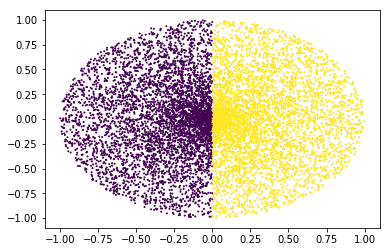

Metrics for random distribution.
Probability 0.4986986986986987 0.5168831168831168
Center of Mass Shift 0.004145483468161724 0.004153782734364296


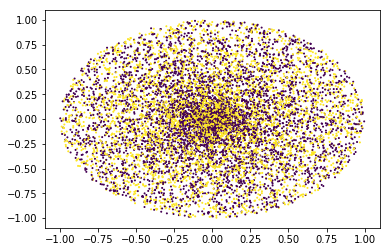

Metrics for smaller circle inside larger circle.
Probability 0.9986438556227832 0.9855072463768116
Center of Mass Shift 0.7217003183564176 0.031168780700975895


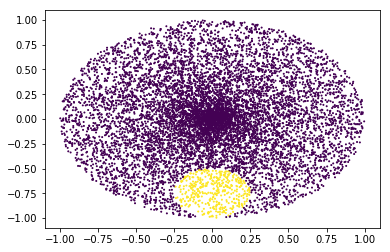

In [23]:
dist = np.random.random(size=10000)
angle = np.random.uniform(0, 2*np.pi, size=10000)
coords = pd.DataFrame({'X': dist*np.cos(angle), 'Y': dist*np.sin(angle), 'cluster_id': np.zeros(len(dist))})

# first experiment with split down the middle 
top = TreeNode(name = 'circle')
top.add_features(coords=coords)
coords.loc[coords['X'] < 0, 'cluster_id'] = 0
left_coords = coords[coords['X'] < 0]
left_node = TreeNode(name='left')
left_node.add_features(coords=left_coords[['X', 'Y']])
coords.loc[coords['X'] > 0, 'cluster_id'] = 1
right_coords = coords[coords['X'] > 0]
right_node = TreeNode(name='right')
right_node.add_features(coords=right_coords[['X', 'Y']])
top.add_child(right_node)
top.add_child(left_node)
print('Metrics for split down the middle.')
print('Probability', probability_neighbor_same(coords, 0), probability_neighbor_same(coords, 1))
print('Center of Mass Shift', center_mass_shift(right_node), center_mass_shift(left_node))
scatter = plt.scatter(coords['X'], coords['Y'], c=coords['cluster_id'], s=1)
plt.show()

# next experiment with random split of points 
coords = pd.DataFrame({'X': dist*np.cos(angle), 'Y': dist*np.sin(angle), 'cluster_id': np.random.choice(2, size=10000)})
top = TreeNode(name = 'circle')
top.add_features(coords=coords)
left_coords = coords[coords['cluster_id'] == 0]
left_node = TreeNode(name='left')
left_node.add_features(coords=left_coords[['X', 'Y']])
right_coords = coords[coords['cluster_id'] == 1]
right_node = TreeNode(name='right')
right_node.add_features(coords=right_coords[['X', 'Y']])
top.add_child(right_node)
top.add_child(left_node)
print('Metrics for random distribution.')
print('Probability', probability_neighbor_same(coords, 0), probability_neighbor_same(coords, 1))
print('Center of Mass Shift', center_mass_shift(right_node), center_mass_shift(left_node))
scatter = plt.scatter(coords['X'], coords['Y'], c=coords['cluster_id'], s=1)
plt.show()

# next experiment with other class of points in smaller circle at bottom of circle 
coords = pd.DataFrame({'X': dist*np.cos(angle), 'Y': dist*np.sin(angle), 'cluster_id': np.zeros(len(dist))})
for ind, row in coords.iterrows():
    if np.linalg.norm(row[['X', 'Y']] - np.array([0, -0.75])) < 0.25:
         coords.loc[ind, 'cluster_id'] = 1
top = TreeNode(name = 'circle')
top.add_features(coords=coords)
left_coords = coords[coords['cluster_id'] == 0]
left_node = TreeNode(name='left')
left_node.add_features(coords=left_coords[['X', 'Y']])
right_coords = coords[coords['cluster_id'] == 1]
right_node = TreeNode(name='right')
right_node.add_features(coords=right_coords[['X', 'Y']])
top.add_child(right_node)
top.add_child(left_node)
print('Metrics for smaller circle inside larger circle.')
print('Probability', probability_neighbor_same(coords, 0), probability_neighbor_same(coords, 1))
print('Center of Mass Shift', center_mass_shift(right_node), center_mass_shift(left_node))
scatter = plt.scatter(coords['X'], coords['Y'], c=coords['cluster_id'], s=1)
plt.show()

In [ ]:
side_length = 100
grid = np.array(itertools.product(range(side_length), range(side_length)))
total = side_length*side_length
coords = pd.DataFrame({'X': grid[:, 0], 'Y': grid[:, 1], 'cluster_id': np.zeros(total)})
fractions = [1, 0.99, 1/3, 0.01]

# first plot points of daughter cluster in corner of grid 
for frac in fractions:
    for ind, row in coords.iterrows():
        if row['X'] < np.ceil(np.sqrt(frac*total)) and row['Y'] < np.ceil(np.sqrt(frac*total)):
            coords.loc[ind, 'cluster_id'] = 1
    top = TreeNode(name = 'circle')
    top.add_features(coords=coords)
    left_coords = coords[coords['cluster_id'] == 0]
    left_node = TreeNode(name='left')
    left_node.add_features(coords=left_coords[['X', 'Y']])
    right_coords = coords[coords['cluster_id'] == 1]
    right_node = TreeNode(name='right')
    right_node.add_features(coords=right_coords[['X', 'Y']])
    top.add_child(right_node)
    top.add_child(left_node)
    print('Metrics for daughter points in corner of grid, fraction = {}.'.format(frac))
    print('Probability', probability_neighbor_same(coords, 0), probability_neighbor_same(coords, 1))
    print('Center of Mass Shift', center_mass_shift(right_node), center_mass_shift(left_node))
    scatter = plt.scatter(coords['X'], coords['Y'], c=coords['cluster_id'], s=1)
    plt.show()

### Run Metrics on BALBc-1 Dataset

In [12]:
def build_sample_tree(sample_name, prop_filter=0.1):
    num_clusters, num_neighbors = get_unique_clusters(sample_name)
    fcs_paths = [data_dir + '/' + sample_name + '/' + str(nn) + '/out/' + sample_name + '.fcs' for nn in num_neighbors]
    tree = build_tree(fcs_paths, num_neighbors, prop_filter)
    return tree

def hls2hex(h, l, s):
    return '#%02x%02x%02x' % tuple(map(lambda x: int(x*255),
                                      colorsys.hls_to_rgb(h, l, s)))    

def recreate_tree(tree, color_dict, num_layers=None):
    # build tree with same topology but without the coordinate and metadata labels 
    # use color_dict to color nodes the appropriate colors 
    new_tree = TreeNode(name = tree.name)
    #new_tree = TreeNodeHashable(name = tree.name)
    new_tree.img_style['size'] = 10
    new_tree.img_style['fgcolor'] = color_dict[tree]
    new_tree.img_style['shape'] = 'sphere'
    old_layer = [tree]
    new_layer = [new_tree]
    layer_num = 0
    while old_layer:
        next_old_layer, next_new_layer = [], []
        for ind, node in enumerate(old_layer):
            for child in node.children:
                next_old_layer.append(child)
                new_child = TreeNode(name = child.name)
                #new_child = TreeNodeHashable(name = child.name)
                new_child.img_style['size'] = 10
                new_child.img_style['fgcolor'] = color_dict[child]
                new_child.img_style['shape'] = 'sphere'
                new_layer[ind].add_child(new_child)
                next_new_layer.append(new_child)
        old_layer = next_old_layer
        new_layer = next_new_layer
        layer_num += 1
        if num_layers is not None and layer_num == num_layers:
            break
        
    return new_tree

In [13]:
sample_name = 'BALBc-1'
num_clusters, num_neighbors = get_unique_clusters(sample_name)
fcs_paths = [data_dir + '/' + sample_name + '/' + str(nn) + '/out/' + sample_name + '.fcs' for nn in num_neighbors]
tree = build_sample_tree(sample_name, prop_filter=0.15)
probs = tree_probabilities(sample_name, fcs_paths, num_neighbors, num_clusters, tree)
path_probs = tree_path_probabilities(probs, tree)
pickle.dump(tree, open('tree.pkl', 'wb'))
pickle.dump((num_clusters, num_neighbors), open('num_cluster_neighbors.pkl', 'wb'))
pickle.dump(probs, open('probs.pkl', 'wb'))
pickle.dump(path_probs, open('path_probs.pkl', 'wb'))

/home/alexander/anaconda3/lib/python3.6/site-packages/fcsparser/api.py:332: UserWarning: The default channel names (defined by the $PnS parameter in the FCS file) were not unique. To avoid problems in downstream analysis, the channel names have been switched to the alternate channel names defined in the FCS file. To avoid seeing this warning message, explicitly instruct the FCS parser to use the alternate channel names by specifying the channel_naming parameter.
  warnings.warn(msg)
/home/alexander/anaconda3/lib/python3.6/site-packages/fcsparser/api.py:332: UserWarning: The default channel names (defined by the $PnS parameter in the FCS file) were not unique. To avoid problems in downstream analysis, the channel names have been switched to the alternate channel names defined in the FCS file. To avoid seeing this warning message, explicitly instruct the FCS parser to use the alternate channel names by specifying the channel_naming parameter.
  warnings.warn(msg)


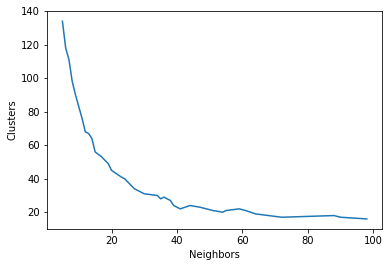

In [50]:
plt.plot(num_neighbors, num_clusters)
plt.xlabel('Neighbors')
plt.ylabel('Clusters')
plt.show()

In [ ]:
def on_plot_hover(event):
    for curve in plot.get_lines():
        if curve.contains(event)[0]:
            print("over %s" % curve.get_gid())

for pp in path_probs:
    pp = np.array(pp)
    fig, ax = plt.subplots()
    ax.plot(pp[:, 0].T, pp[:, 1].T)
    plt.show()

In [5]:
tree = pickle.load(open('tree.pkl', 'rb'))
num_clusters, num_neighbors = pickle.load(open('num_cluster_neighbors.pkl', 'rb'))
probs = pickle.load(open('probs.pkl', 'rb'))
path_probs = pickle.load(open('path_probs.pkl', 'rb'))

In [14]:
supplementary_data = pd.read_csv('../Suppl.Table2.CODEX_paper_MRLdatasetexpression.csv')
supplementary_data_converted = supplementary_data[supplementary_data['sample_Xtile_Ytile'].str.contains('BALBc-1')]
supplementary_data_converted = supplementary_data_converted[['X.X', 'Y.Y', 'Z.Z', 'sample_Xtile_Ytile', 
                                                             'CD45', 'Imaging phenotype cluster ID']]
supplementary_data_converted.rename(columns={'X.X': 'X', 'Y.Y': 'Y', 'Z.Z': 'Z'}, inplace=True)
supplementary_data_converted['CD45_int'] = supplementary_data_converted['CD45'].astype(int)
supplementary_data_converted = convert_coordinates(supplementary_data_converted)
ids_to_names = pd.read_csv('ClusterIDtoName.txt', sep='\t')
cell_lines = list(ids_to_names['ID'].values)
ids_to_names = dict(zip(ids_to_names['ID'].values, ids_to_names['Name'].values))

In [15]:
# create heatmaps of cell lines and how they branch out in the clustering 

def get_paths(tree, num_layers=None):
    if not tree.children or num_layers == 1:
        yield [tree]
    else:
        for subtree in tree.children:
            if num_layers is not None:
                subtree_paths = get_paths(subtree, num_layers - 1)
            else:
                subtree_paths = get_paths(subtree, None)
            for path in subtree_paths:
                yield [tree] + path      
                
def plot_path(line, name, path):
    # hacky function to plot path in tree
    img = mpimg.imread('cell_line_{}_{}.png'.format(name, line))
    fig, ax = plt.subplots(1, 3, figsize=(25, 5))
    ax[0].imshow(img, aspect="auto")
    ax[0].axis('off')
    pp = []
    for node in path[1:]:
        pp.append(probs[node])
    pp = np.array(pp)
    ax[1].plot(np.array(pp[:, 1]).T, np.arange(len(pp)))
    ax[1].invert_yaxis()
    ax[1].set_yticks(np.arange(len(pp)))
    ax[1].set_yticklabels(pp[:, 0])
    ax[2].plot(np.array(pp[:, 2]).T, np.arange(len(pp)))
    ax[2].invert_yaxis()
    ax[2].set_yticks(np.arange(len(pp)))
    ax[2].set_yticklabels(pp[:, 0])
    plt.show()
    
    fig, ax = plt.subplots(1, 3, figsize=(25, 5))
    for i in range(3):
        ax[i].plot(np.array(pp[:, i+3]).T, np.arange(len(pp)))
        ax[i].invert_yaxis()
        ax[i].set_yticks(np.arange(len(pp)))
        ax[i].set_yticklabels(pp[:, 0])
    plt.show()
    plot_path, data, is_peak = [], [], []
    for ind, node in enumerate(path[1:]):
        if 16 <= pp[ind, 0] <= 40:
            plot_path.append(node)
            data.append(pp[ind])
        if 0 < ind < (len(pp) - 1) and pp[ind-1,0] < pp[ind,0] < pp[ind+1,0]:
            is_peak.append('Peak')
        else:
            is_peak.append('Not Peak')
    for ind, node in enumerate(plot_path):
        if ind % 5 == 0:
            fig, ax = plt.subplots(1, 5, figsize=(20, 4))
        scatter = ax[ind%5].scatter(node.coords['X'], node.coords['Y'], s=0.1)
        ax[ind%5].set_title('Clusters = {}, Prob = {}, {}'.format(int(data[ind][0]), np.round(data[ind][1], 2), is_peak[ind]))
        if ind % 5 == 4:
            plt.show()
    if ind % 5 != 4:
        for i in range(1, 5 - ind%5):
            ax[ind%5 + i].axis('off')
        plt.show()

def show_path_clusters(line, name, num_paths=50, num_layers=None):
    # plot some paths in the tree and their corresponding clusters 
    total = 0
    for path in get_paths(tree, num_layers):
        print('Plotting probabilities for new path.')
        # exclude root of tree when plotting 
        plot_path(line, name, path)
        total += 1
        if total == num_paths:
            break
            
def plot_densest_cell_line_paths(line, name, num_layers=None, num_paths=5):
    print('Plotting densest paths for cell line {} with ID {}'.format(name, line))
    suppl_line_data = supplementary_data_converted[supplementary_data_converted['Imaging phenotype cluster ID'] == line]
    overlap = {}
    path_total_frac = {}
    for path in get_paths(tree, num_layers):
        total_fraction = 0
        for node in path:
            if node not in overlap:
                percent_overlap = pd.merge(suppl_line_data, node.coords, 
                                       on=['X', 'Y', 'Z']).shape[0] / suppl_line_data.shape[0]
                overlap[node] = percent_overlap
            total_fraction += overlap[node]
        path_total_frac[tuple(path)] = total_fraction
    
    densest = dict(sorted(list(path_total_frac.items()), key=lambda x: x[1])[-num_paths:])
    for path in densest:
        plot_path(line, name, path)

def visualize_cell_line_split(line, name, num_layers=None, save=True):
    # get percentages of each cell line in each cluster, and make a heatmap for each 
    suppl_line_data = supplementary_data_converted[supplementary_data_converted['Imaging phenotype cluster ID'] == line]
    color_dict = {}
    color_dict[tree] = hls2hex(0, 0, 0)
    layer = tree.children
    for i in range(len(num_clusters)):
        for ind, node in enumerate(layer):
            percent_overlap = pd.merge(suppl_line_data, node.coords, 
                                       on=['X', 'Y', 'Z']).shape[0] / suppl_line_data.shape[0]
            color_dict[node] = hls2hex(1 - percent_overlap, 1 - percent_overlap, 1 - percent_overlap)
        new_layer = []
        for node in layer:
            new_layer += node.children
        layer = new_layer
        
    new_tree = recreate_tree(tree, color_dict, num_layers)
    ts = TreeStyle()
    ts.show_leaf_name = False
    ts.rotation = 90
    if save:
        new_tree.render('cell_line_{}_{}.png'.format(name, line), tree_style=ts)
    else:
        return new_tree.render('%%inline', tree_style=ts)
    
def visualize_spearman_metric(num_layers=None, save=True):
    # 

In [83]:
for line in cell_lines:
    name = ids_to_names[line]
    if not os.path.isfile('cell_line_{}_{}.png'.format(name, line)):
        visualize_cell_line_split(line, name, num_layers=25, save=True)

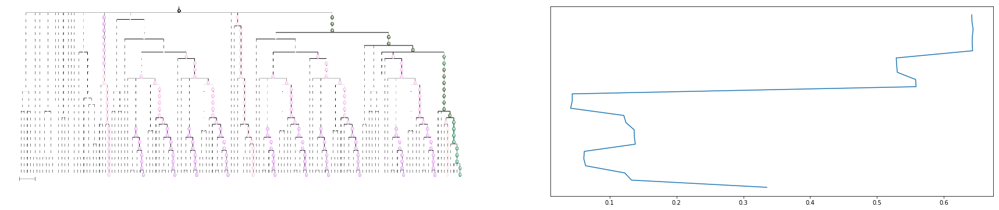

In [18]:
img = mpimg.imread('cell_line.png')
fig, ax = plt.subplots(1, 2, figsize=(30, 6))
ax[0].imshow(img, aspect="auto")
ax[0].axis('off')
pp = np.array(path_probs[0])
#ax[1].plot(np.array(pp[:25, 1]).T, np.array(pp[:25, 0]).T)
ax[1].plot(np.array(pp[:25, 1]).T, np.arange(25))
#ax[1].invert_yaxis()
ax[1].get_yaxis().set_ticks([])
plt.show()

In [ ]:
show_path_clusters(cell_lines[0], ids_to_names[cell_lines[0]], num_paths=50, num_layers=25)

In [ ]:
# plot tree where we highlight each node based on the spearman correlation metric 

Plotting densest paths for cell line plasma cells with ID 9626


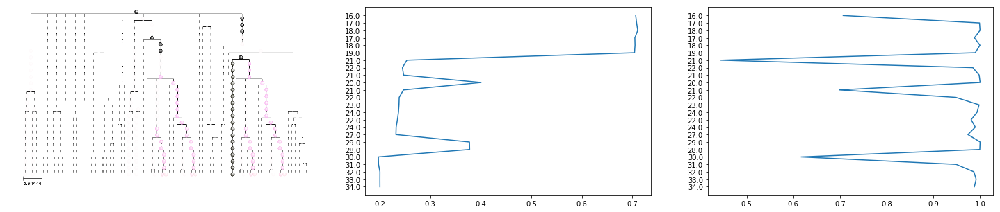

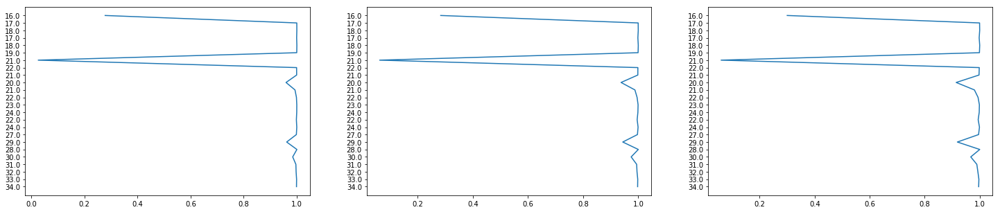

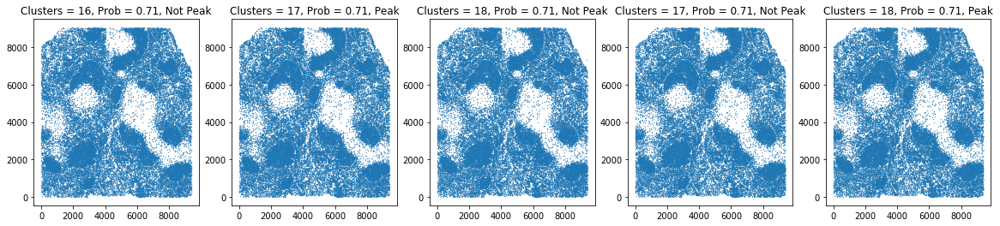

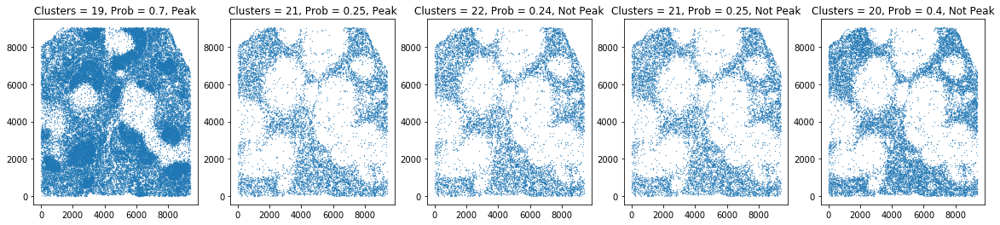

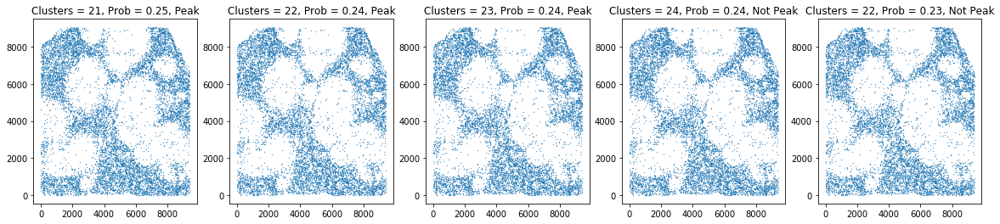

...

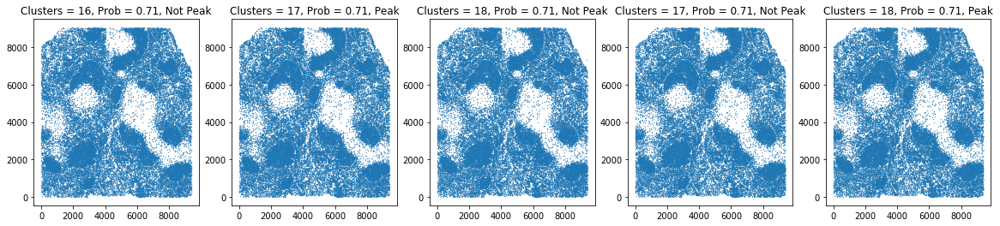

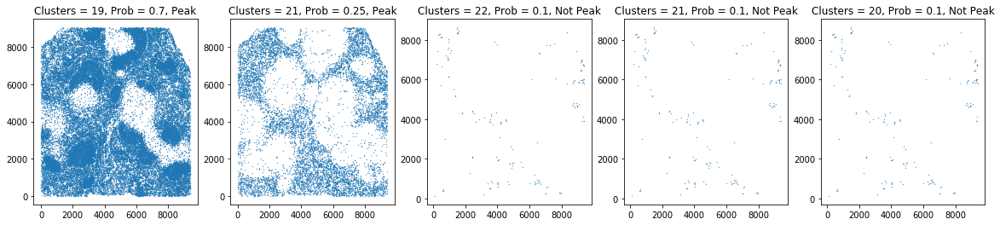

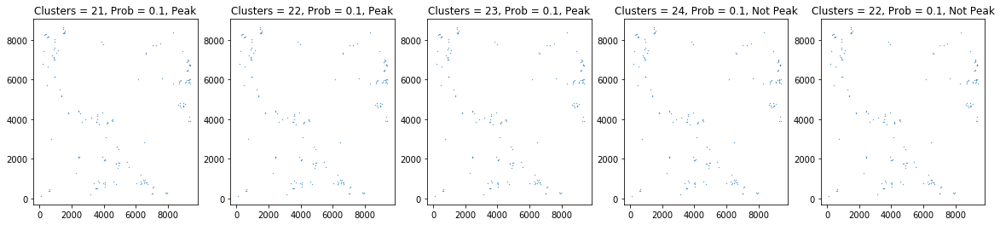

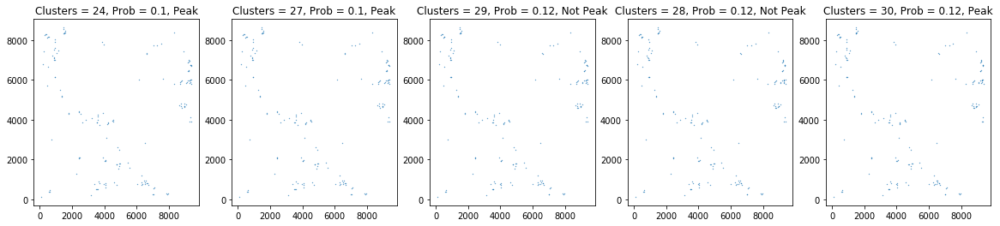

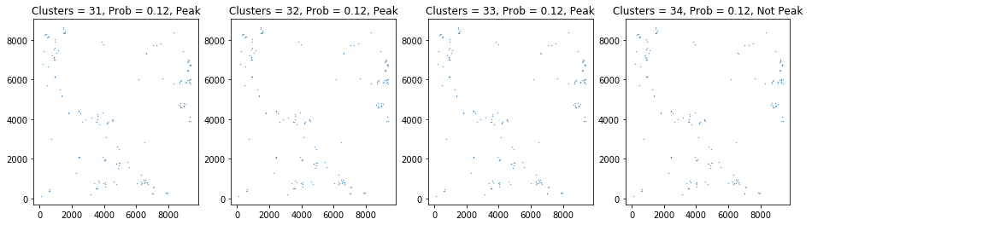

Plotting densest paths for cell line plasma cells with ID 9593


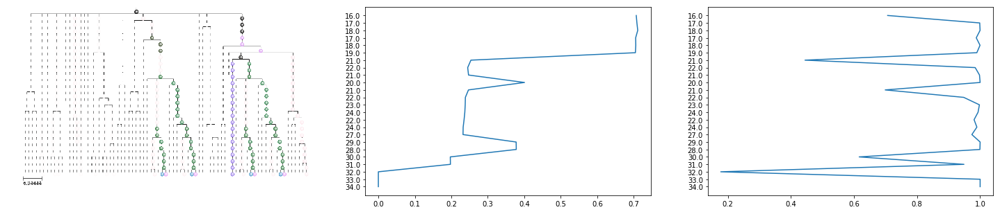

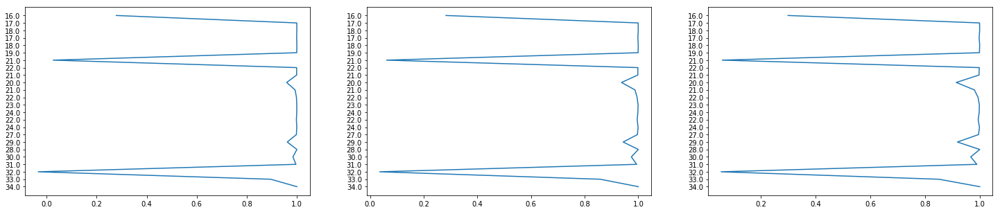

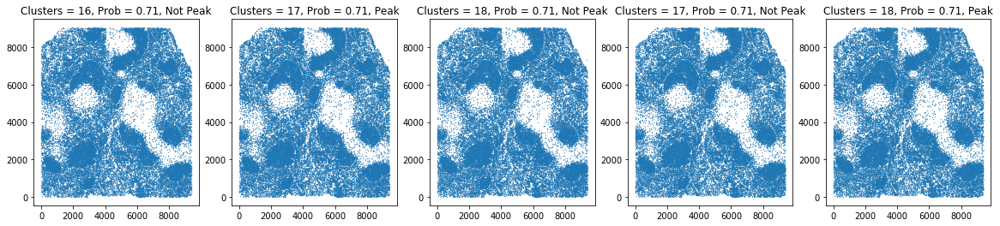

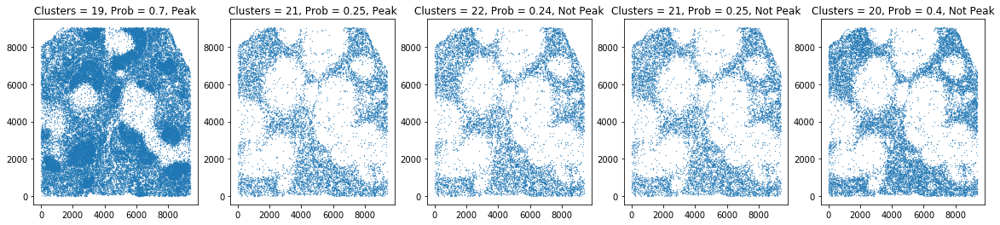

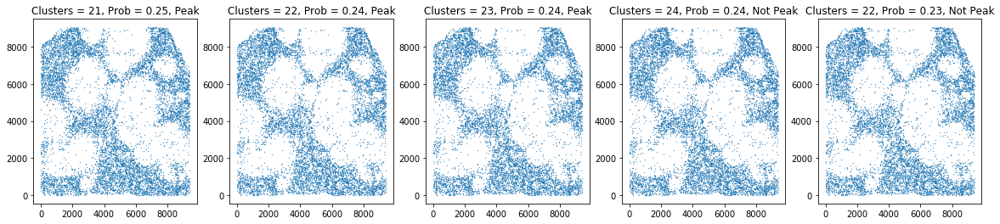

...

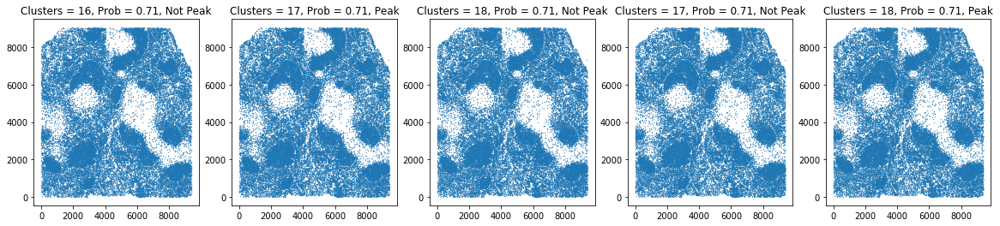

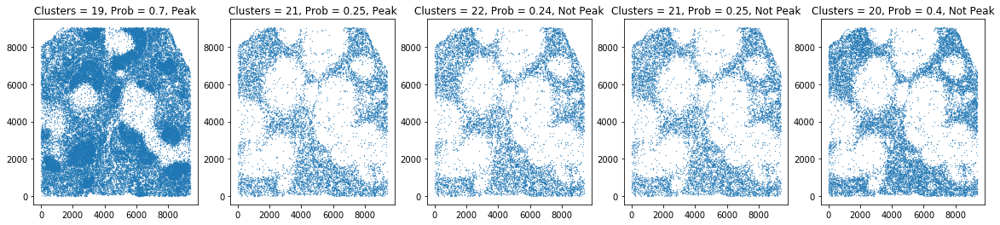

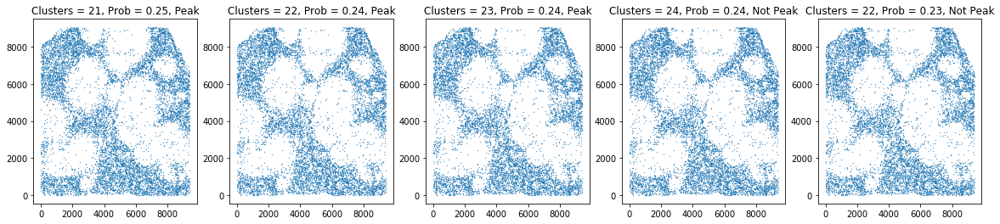

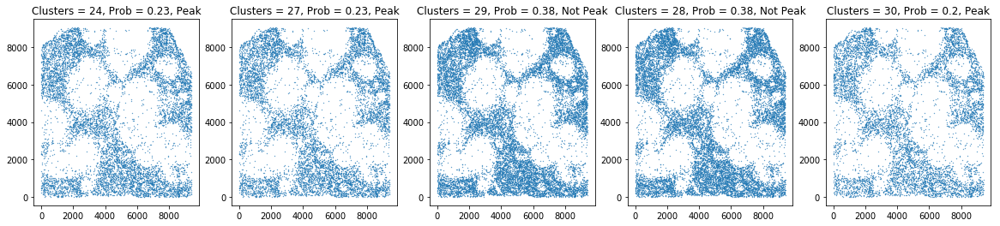

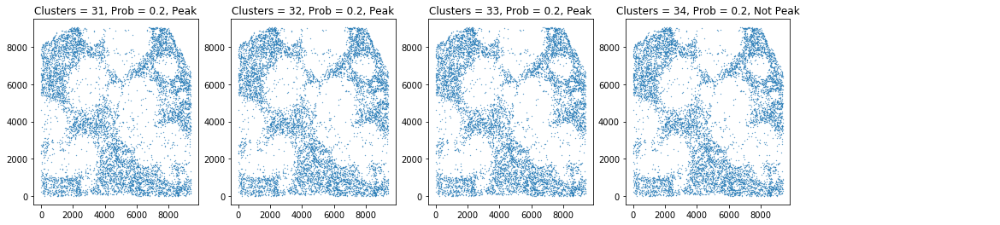

Plotting densest paths for cell line noid with ID 9641


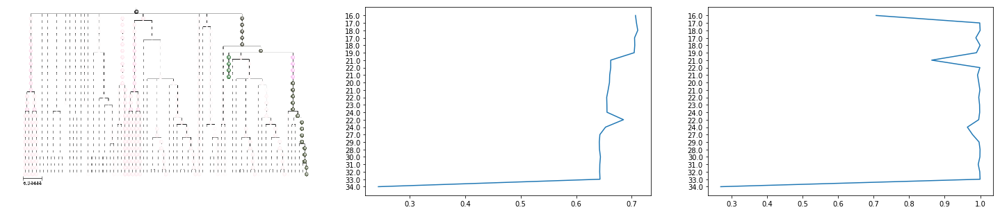

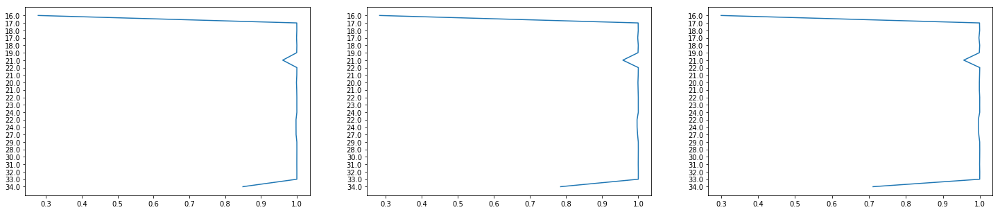

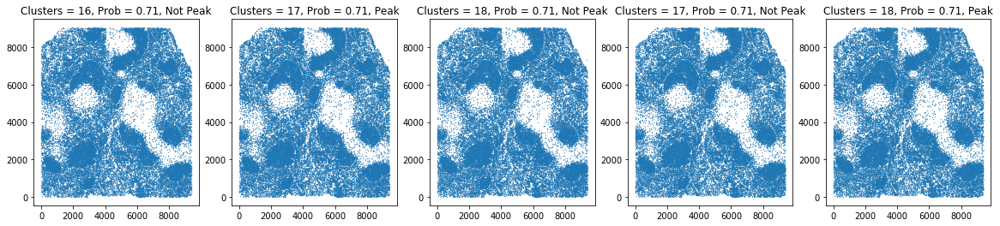

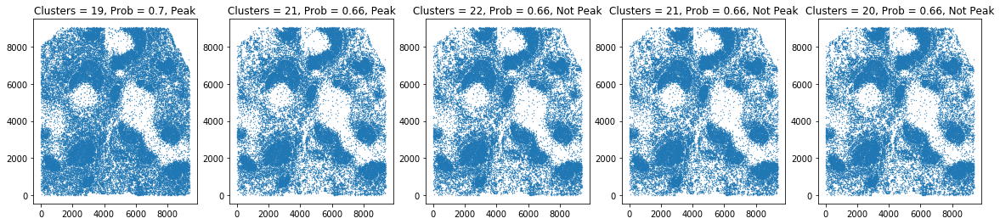

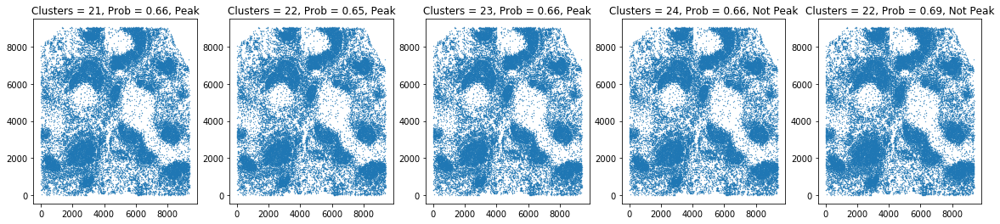

...

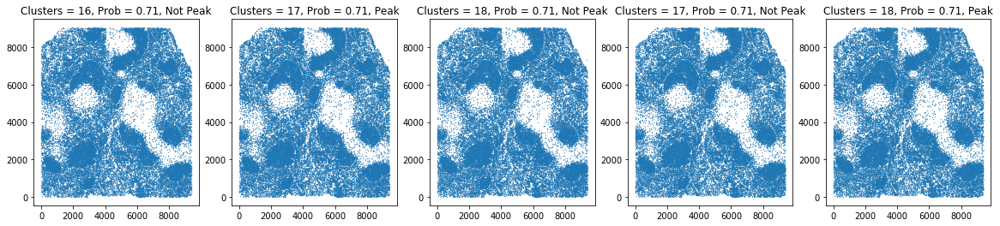

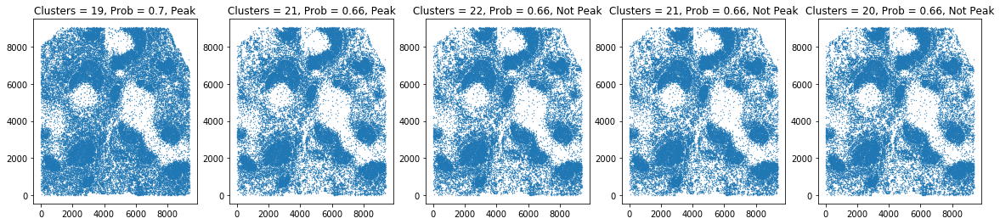

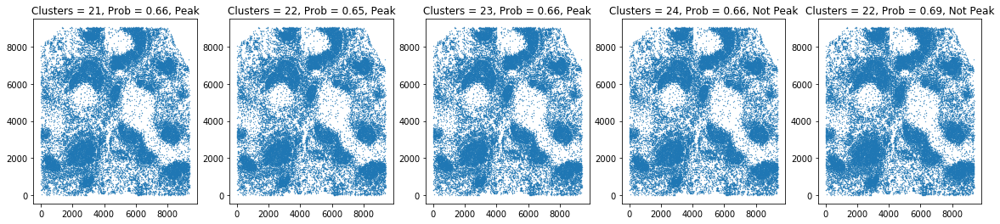

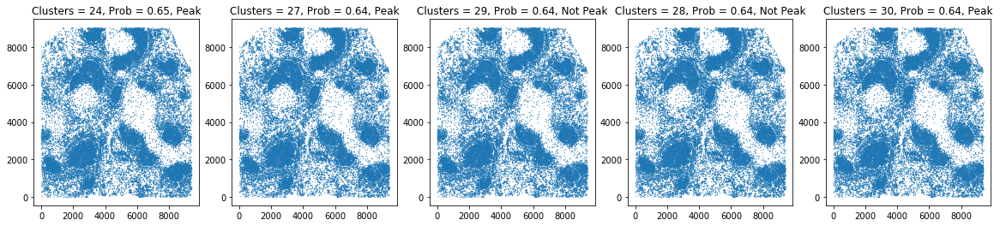

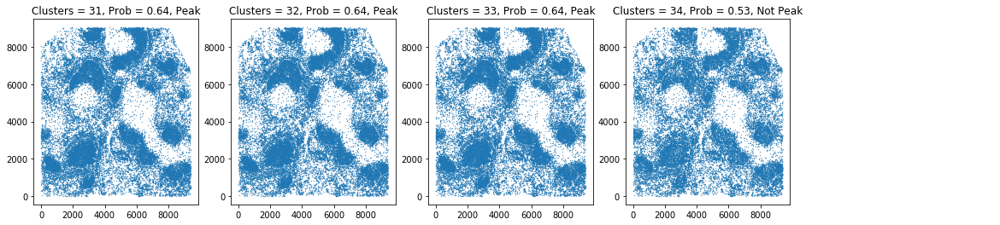

Plotting densest paths for cell line noid with ID 9644


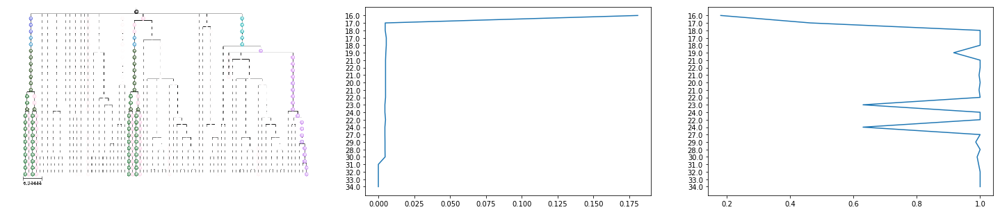

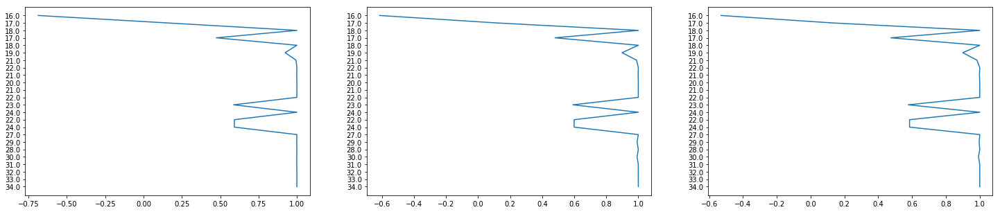

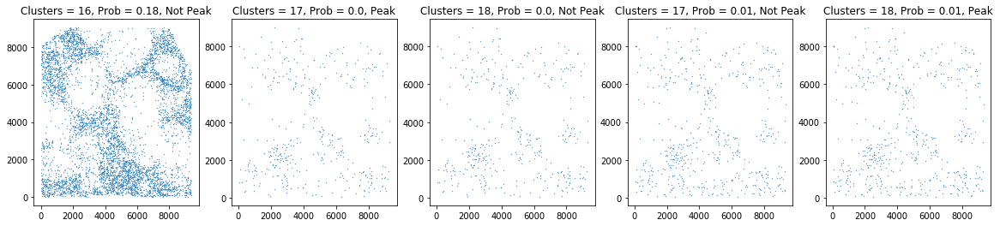

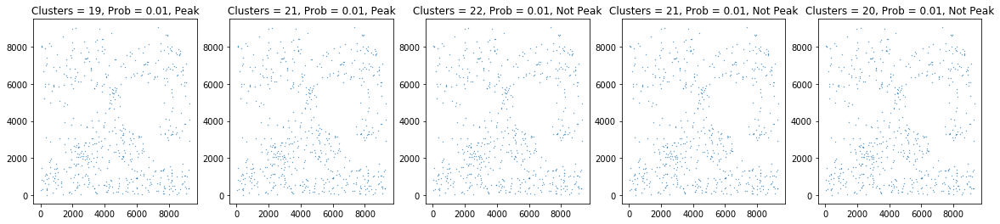

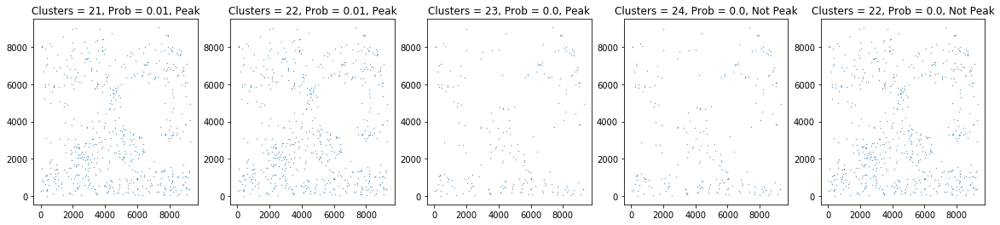

...

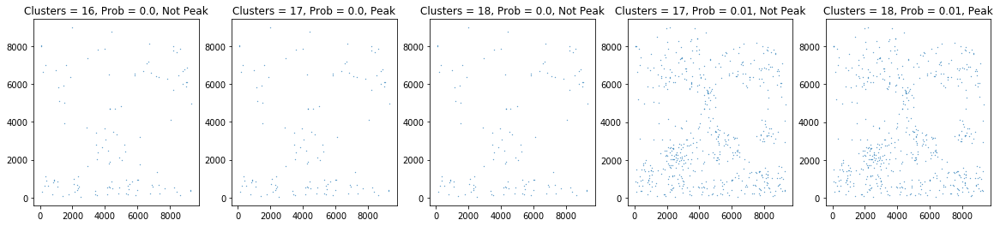

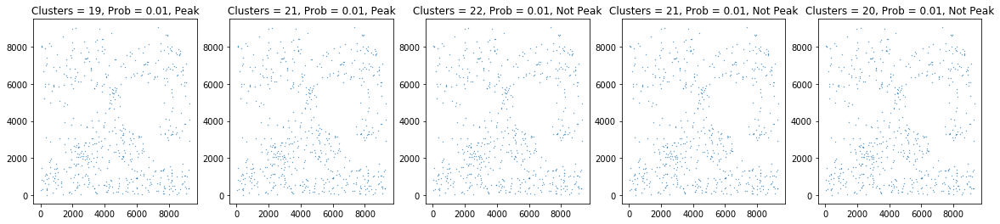

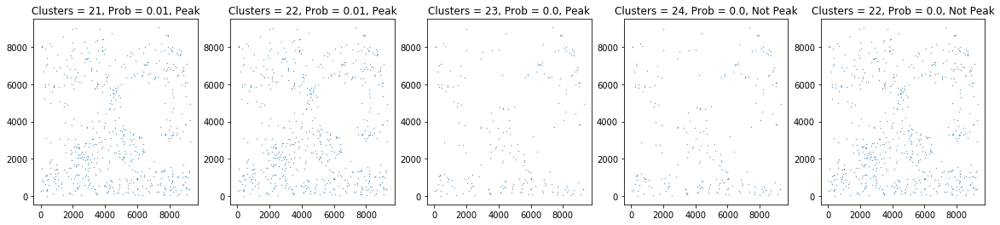

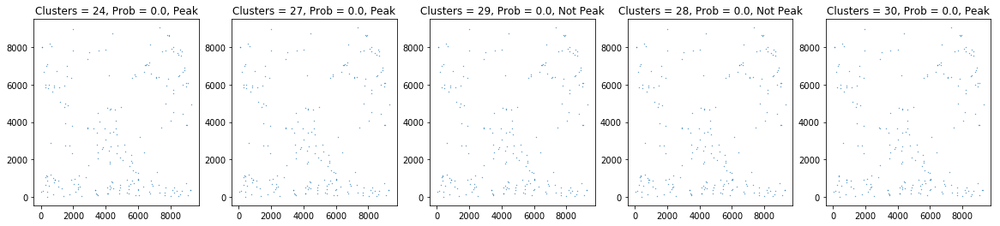

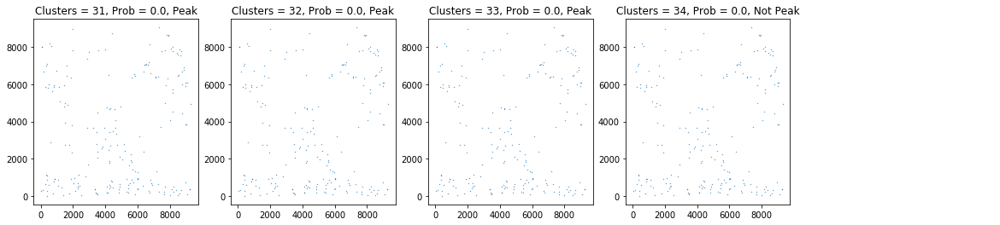

Plotting densest paths for cell line noid with ID 9605


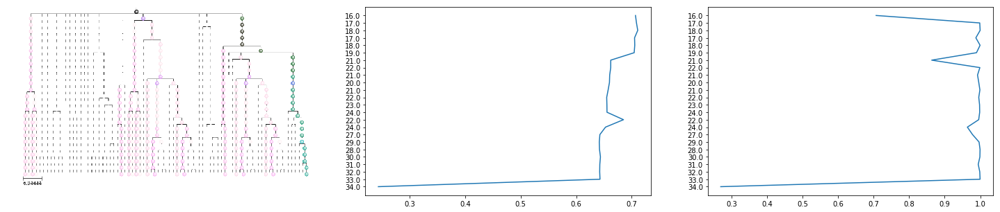

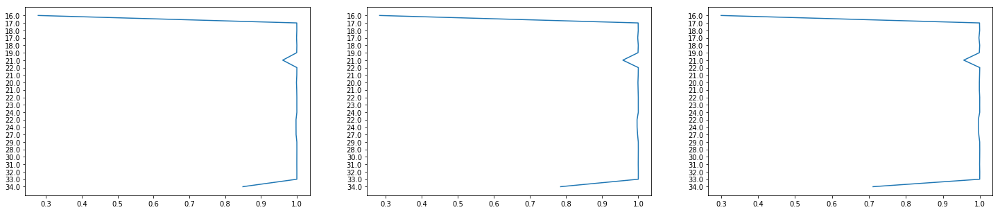

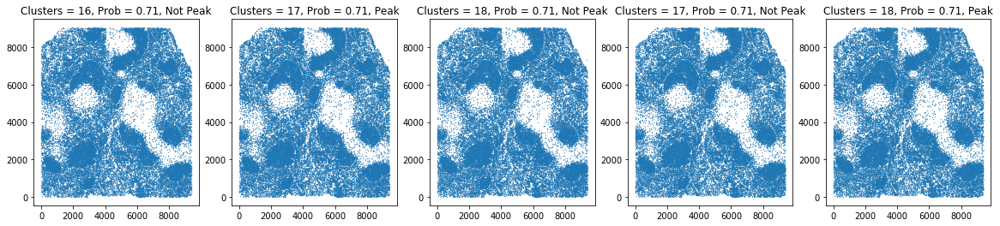

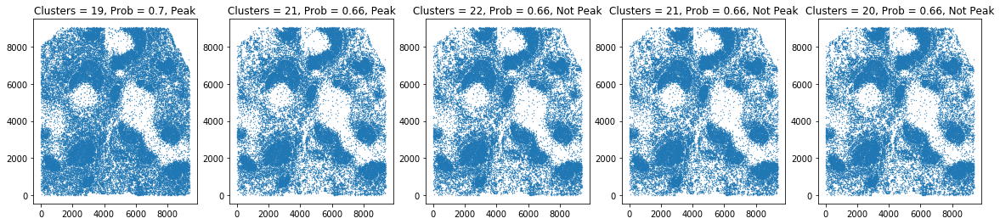

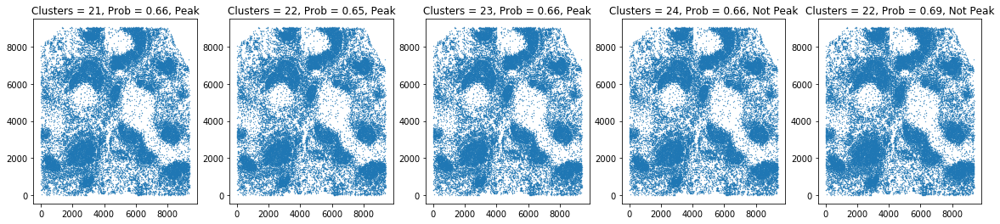

...

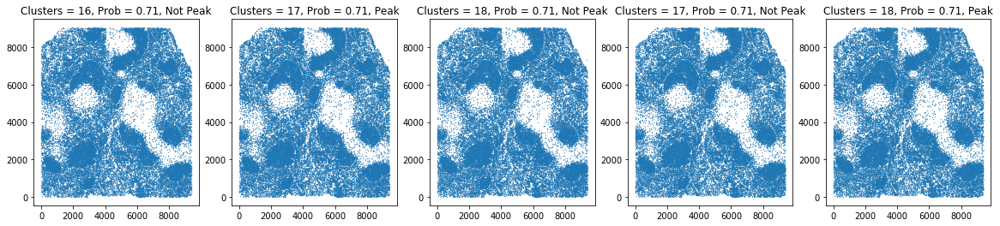

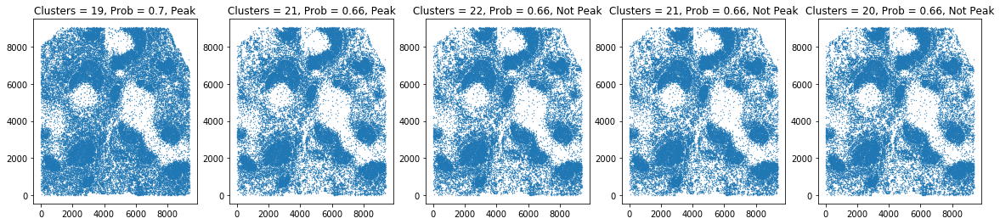

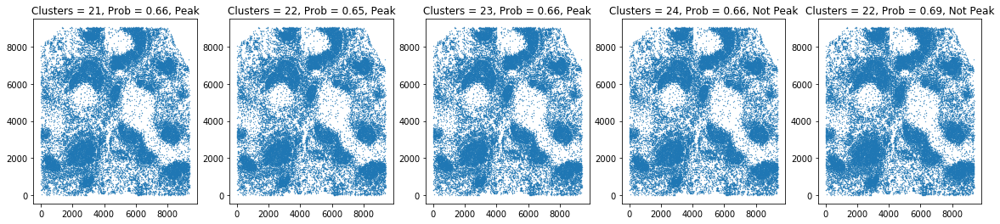

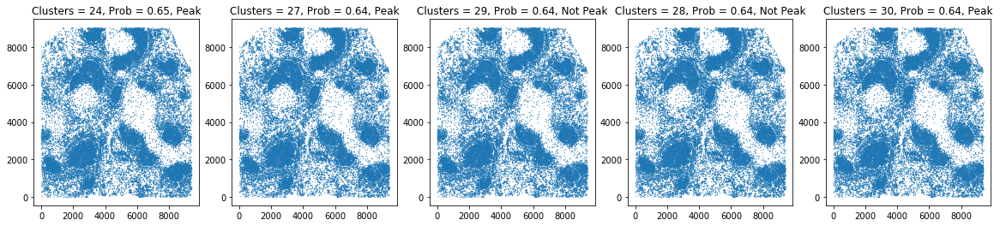

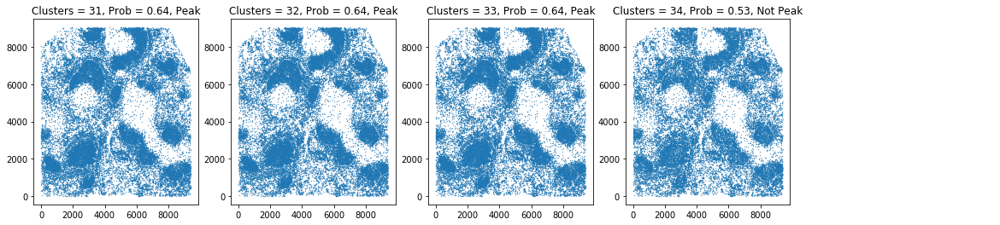

Plotting densest paths for cell line megakaryocytes with ID 9615


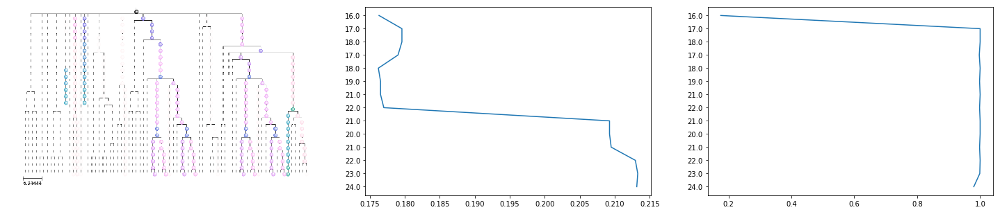

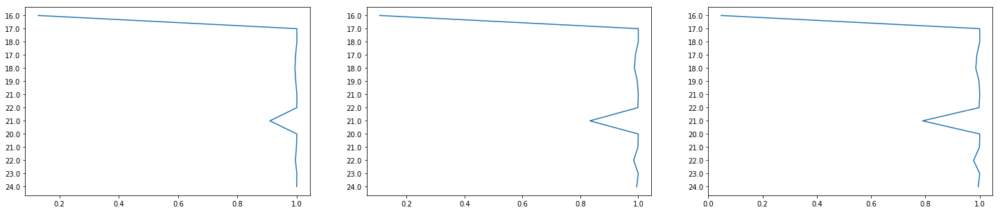

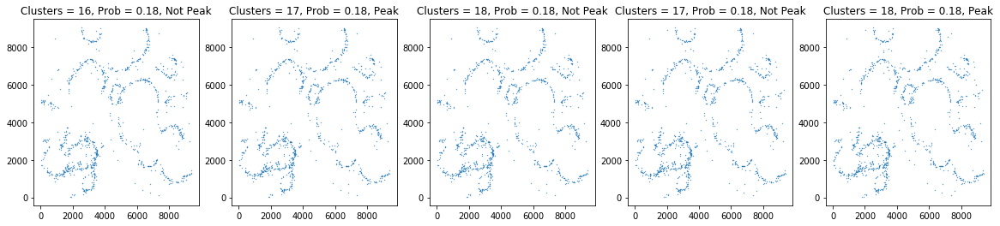

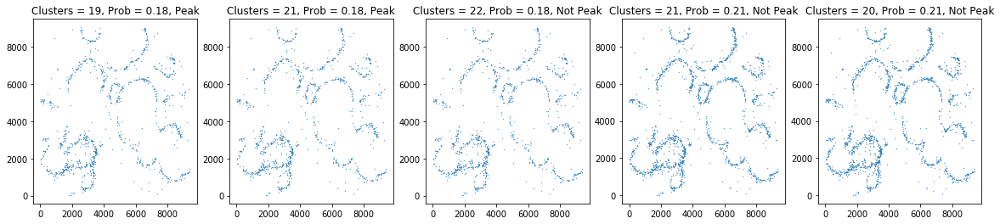

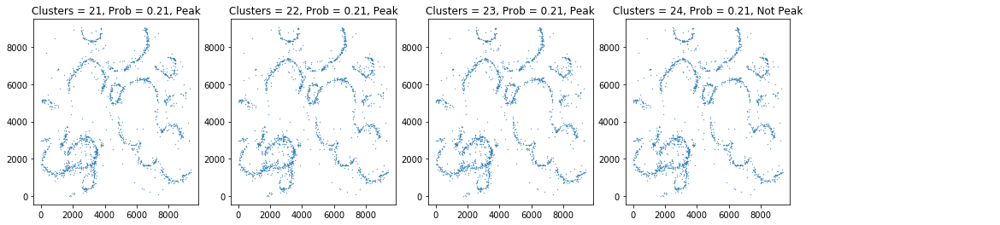

...

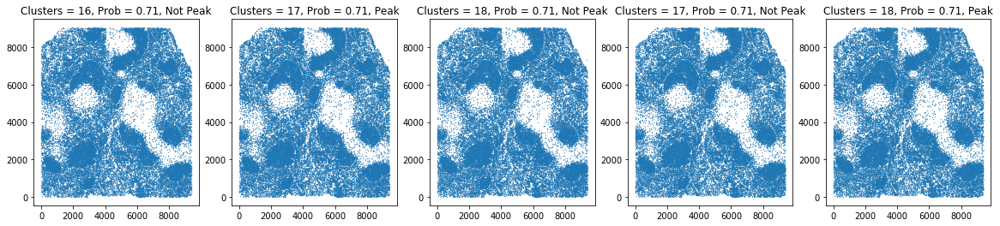

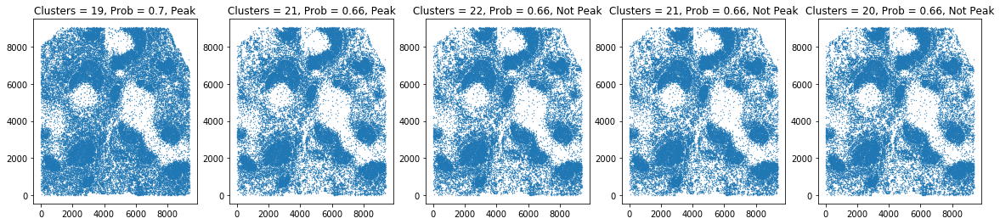

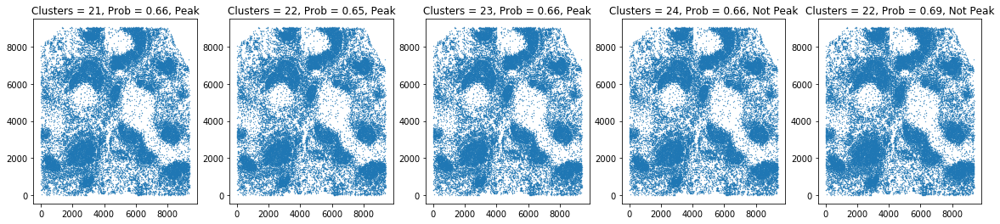

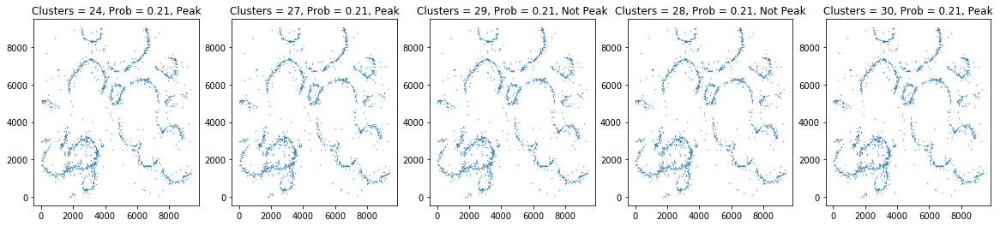

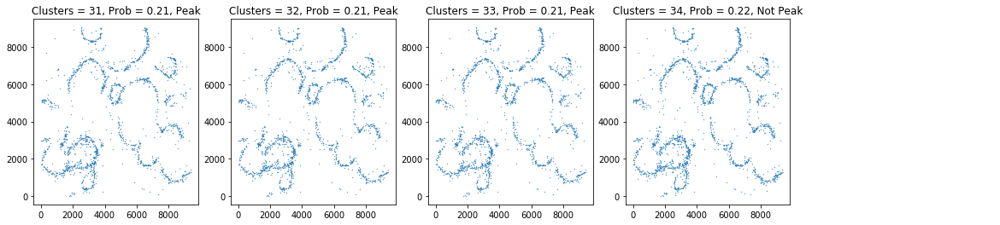

Plotting densest paths for cell line marginal zone macrophages with ID 9602


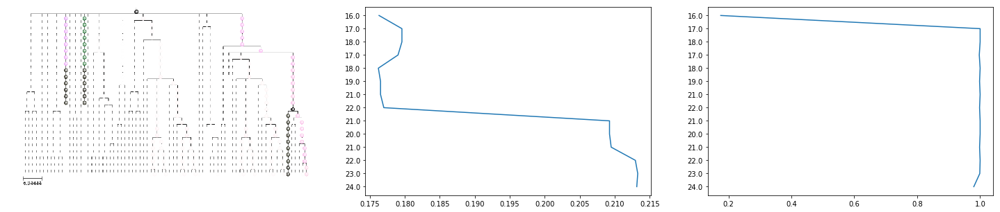

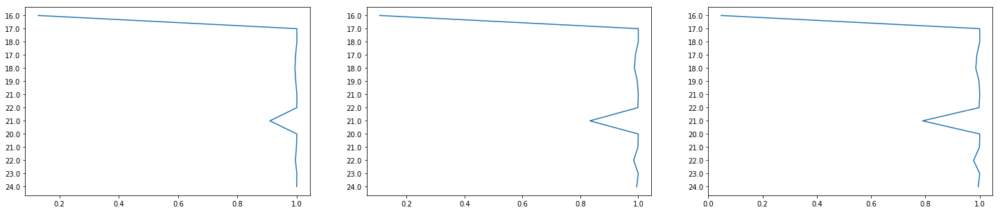

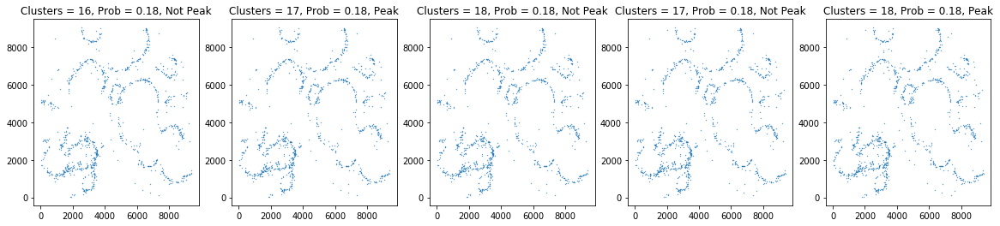

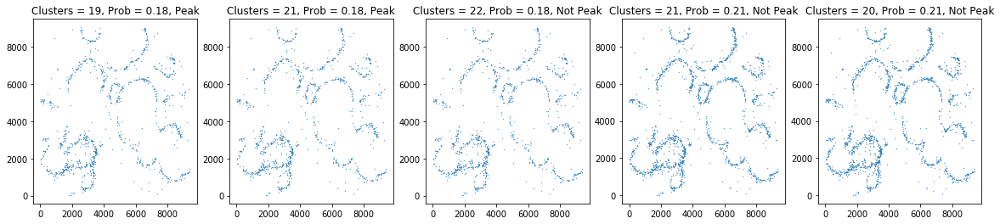

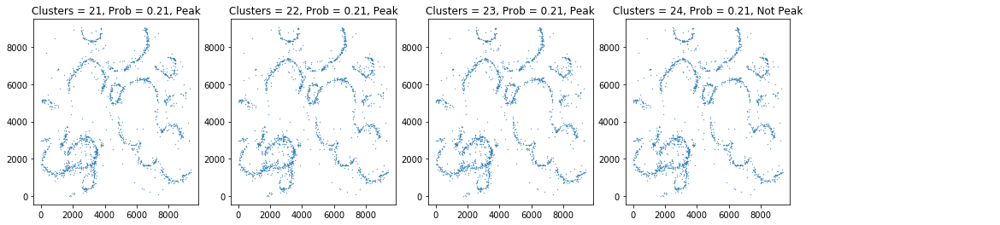

...

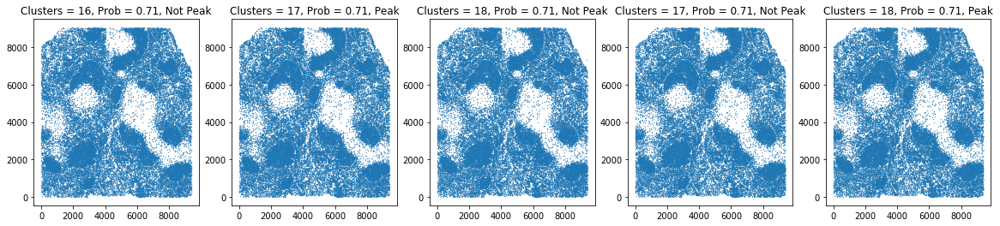

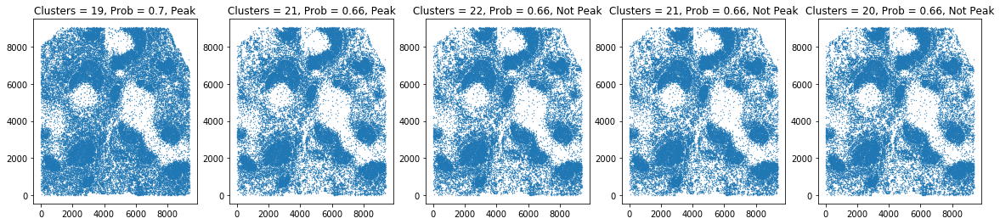

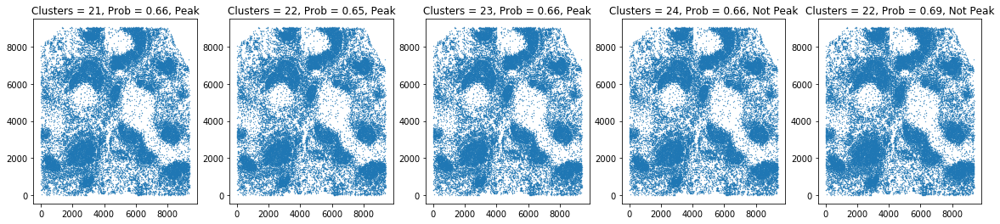

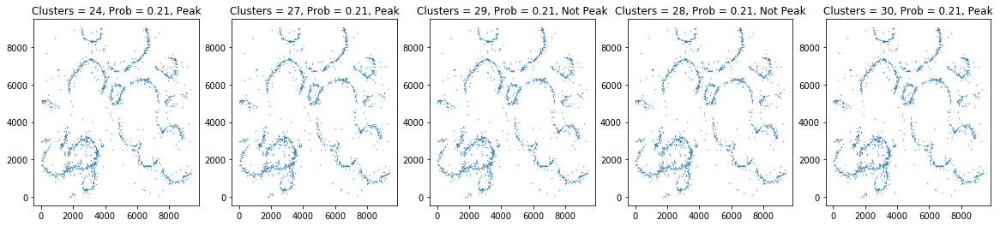

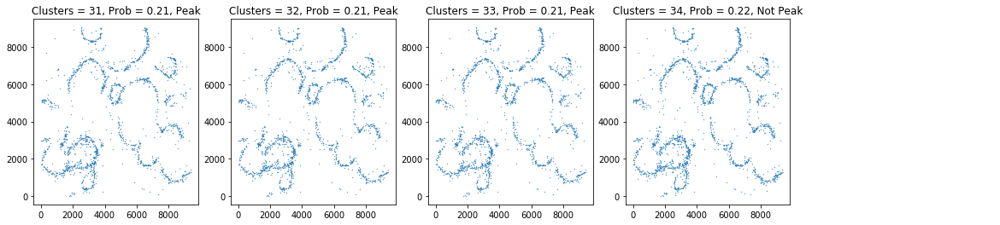

Plotting densest paths for cell line marginal zone macrophages with ID 9604


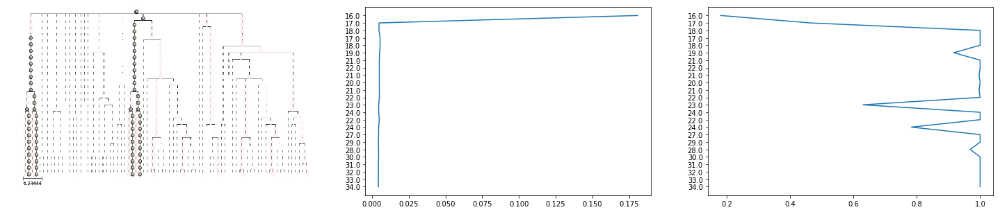

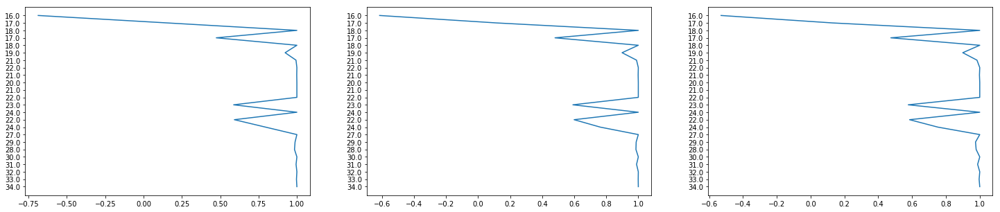

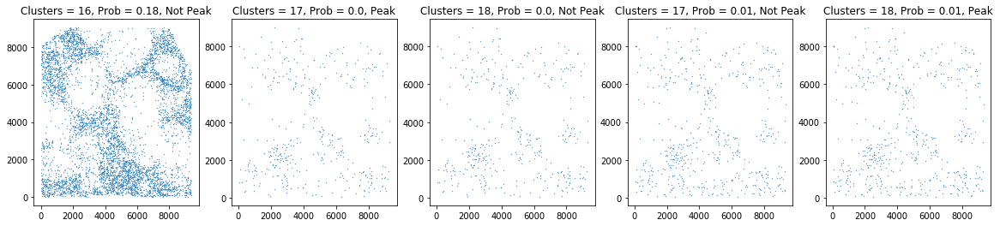

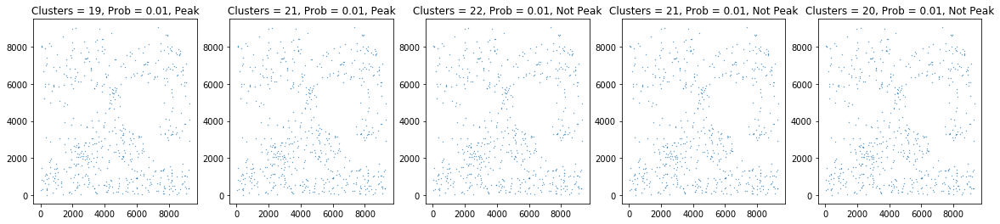

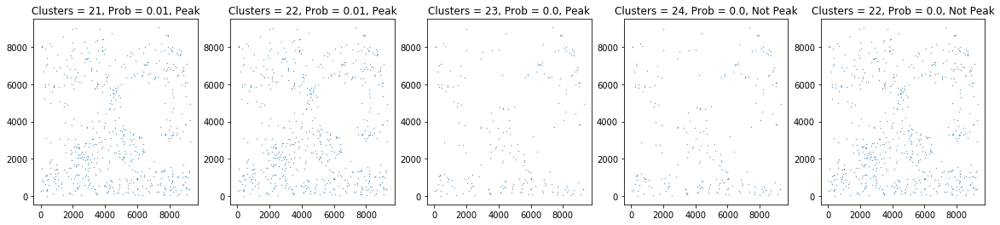

...

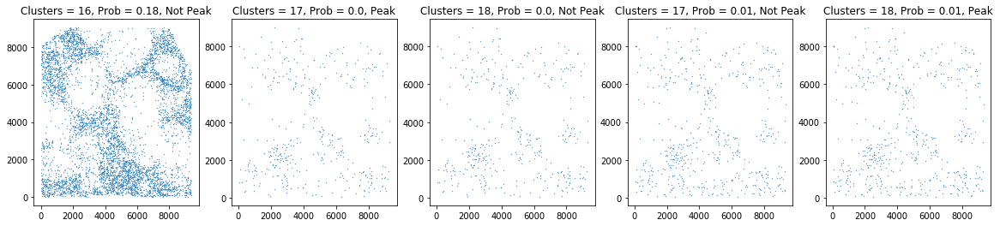

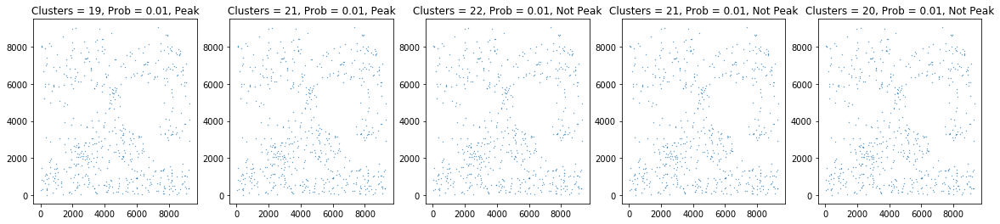

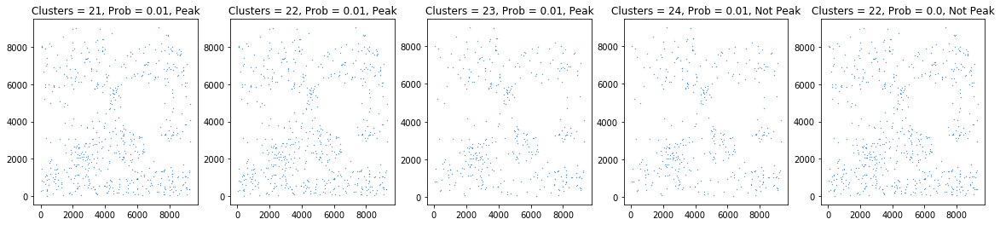

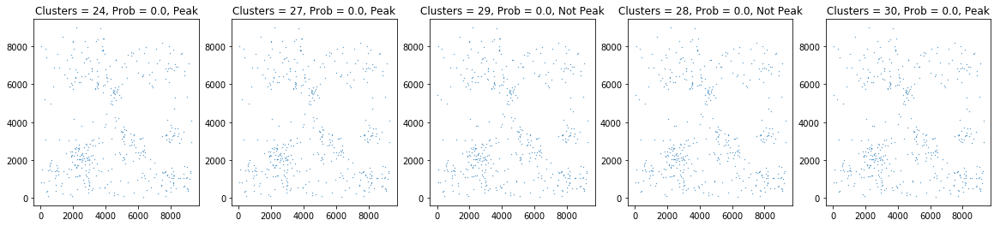

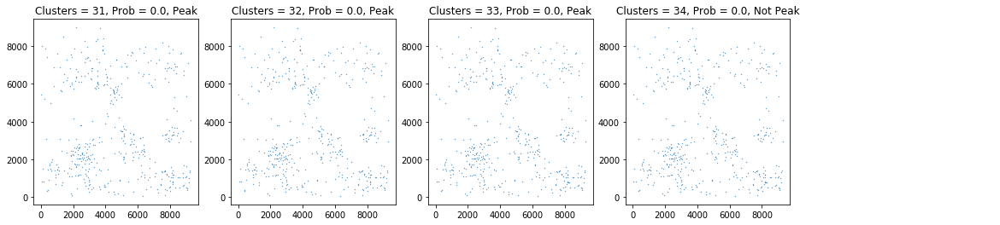

Plotting densest paths for cell line marginal zone macrophages with ID 9620


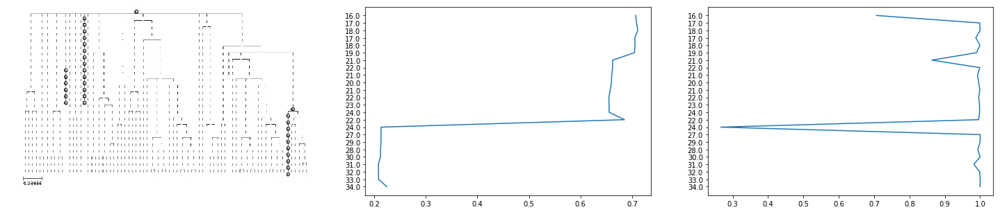

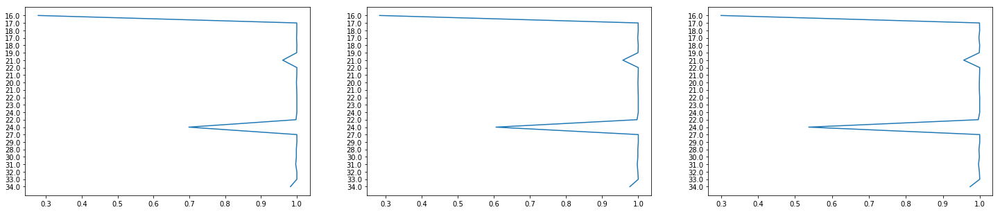

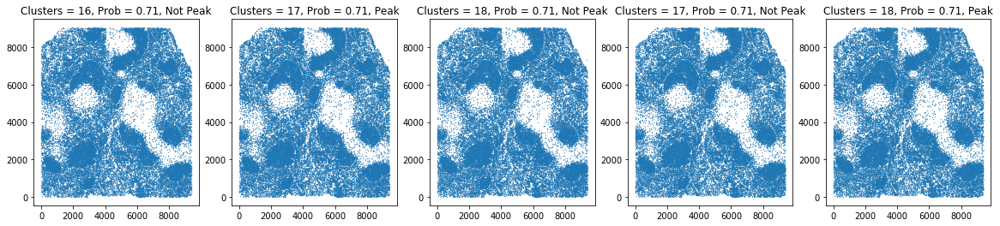

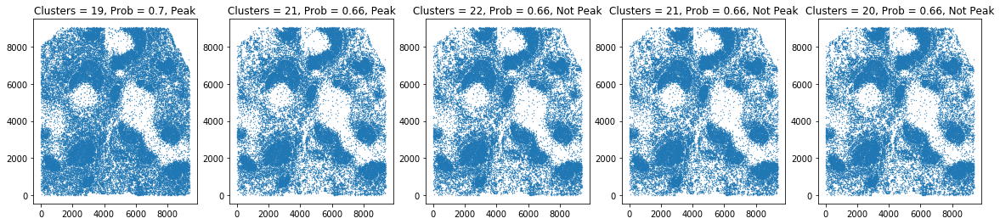

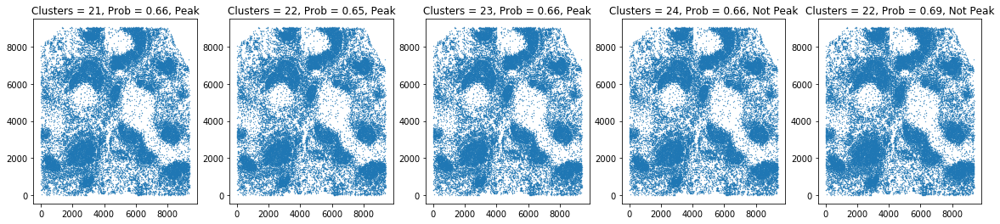

...

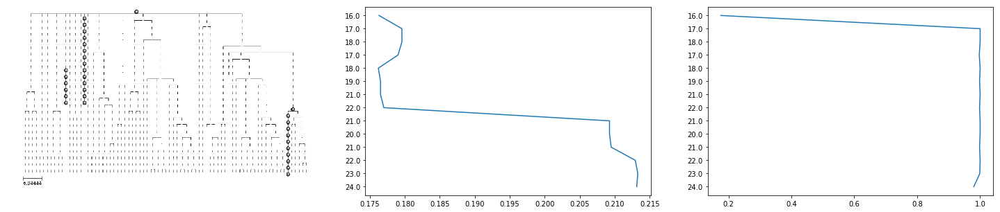

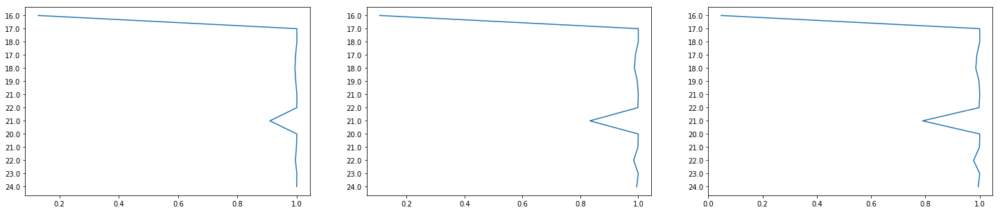

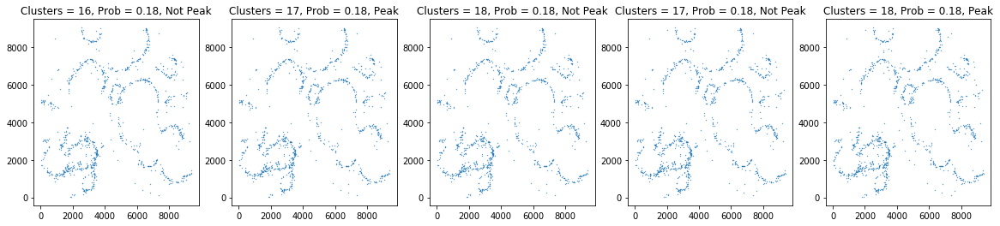

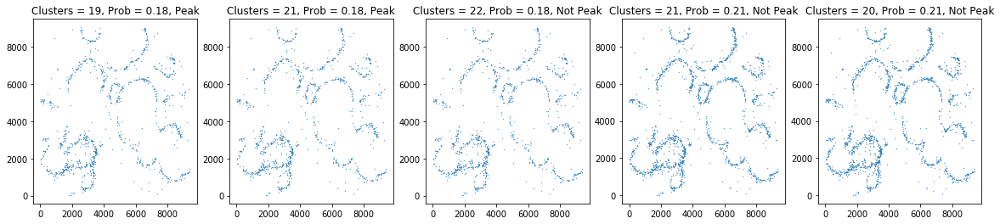

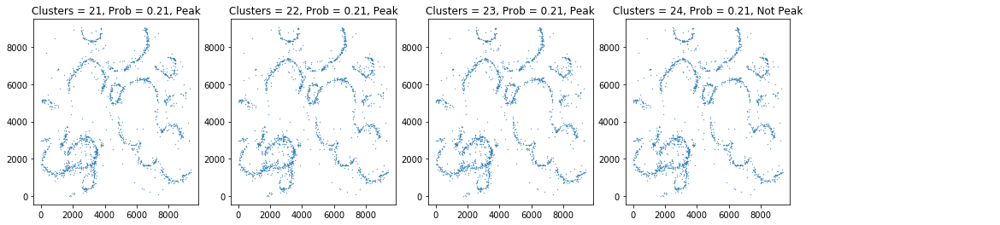

Plotting densest paths for cell line granulocytes with ID 9609


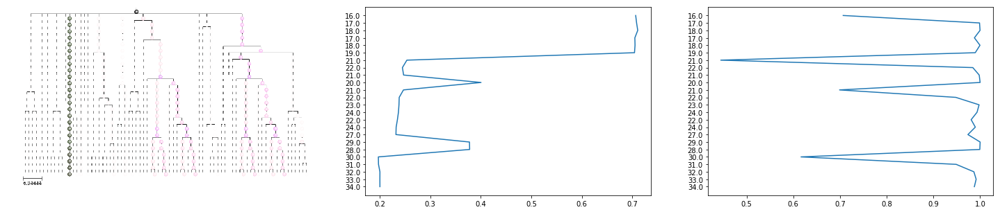

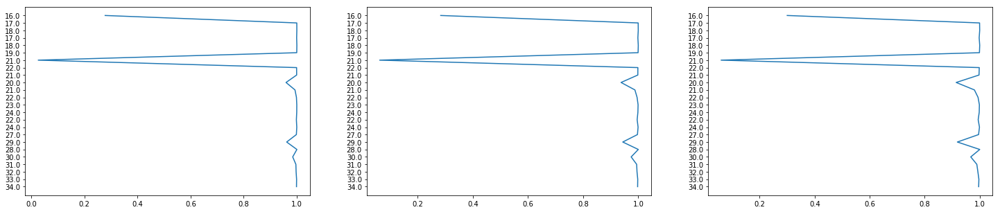

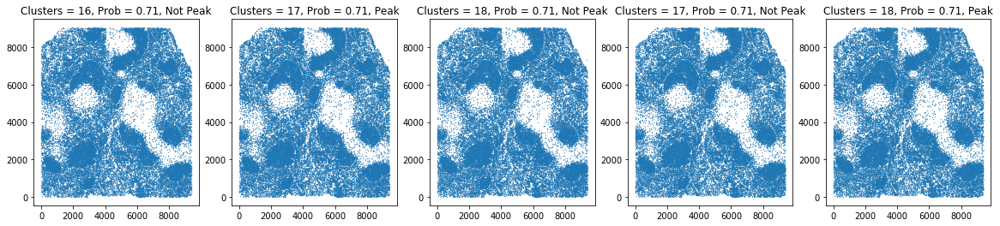

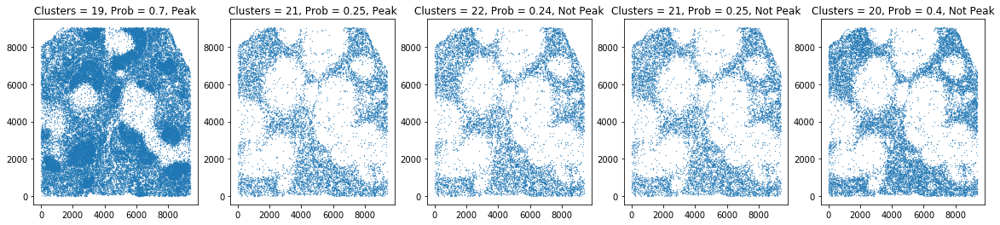

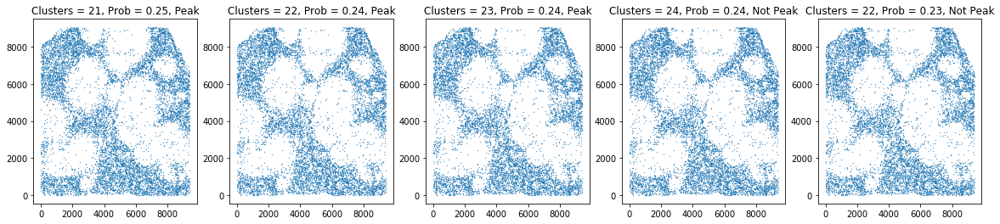

...

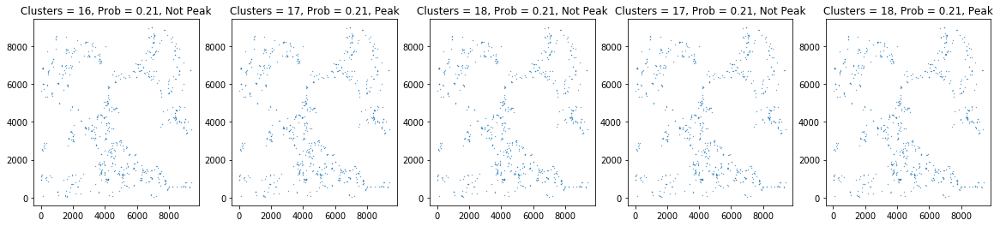

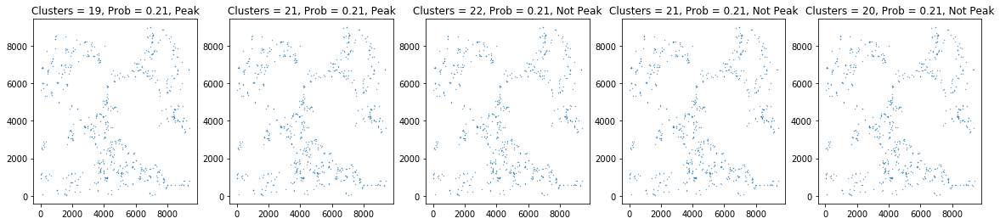

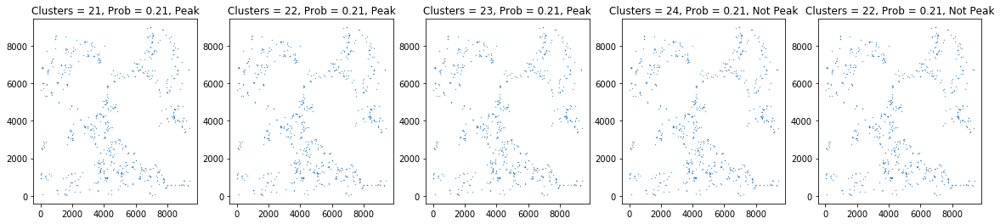

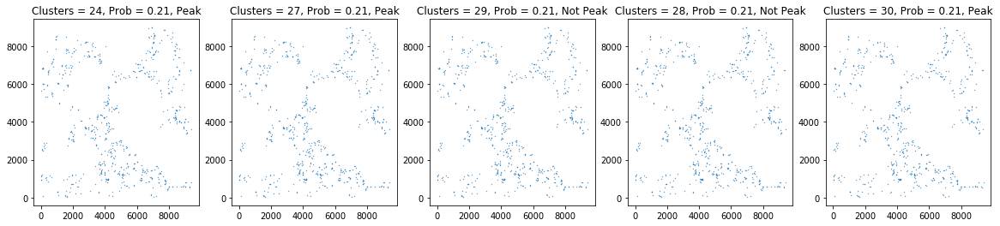

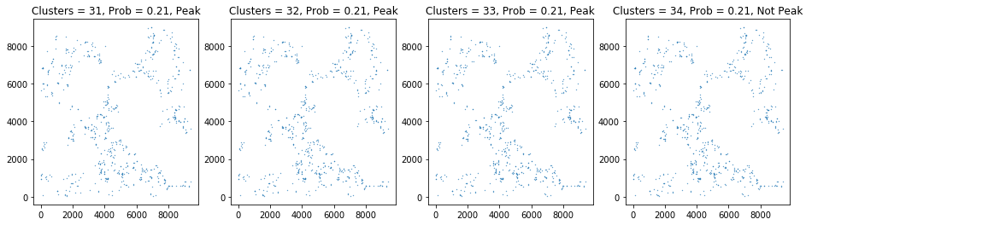

Plotting densest paths for cell line granulocytes with ID 9589


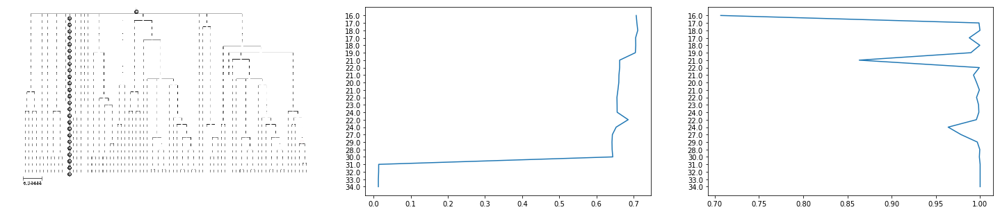

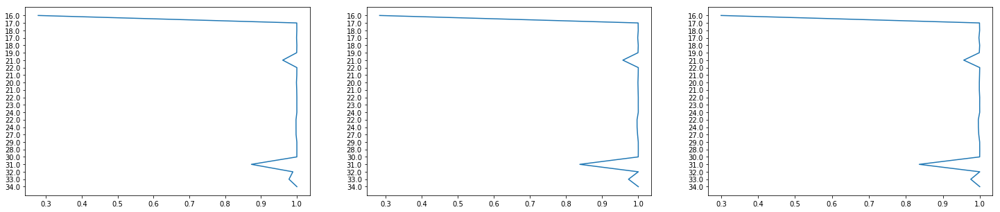

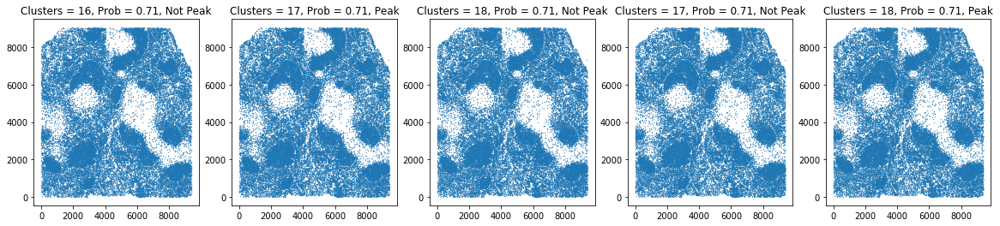

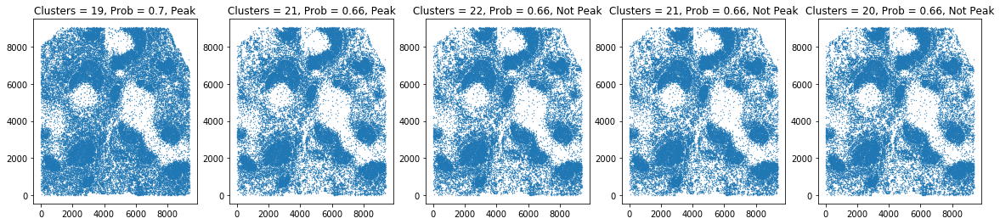

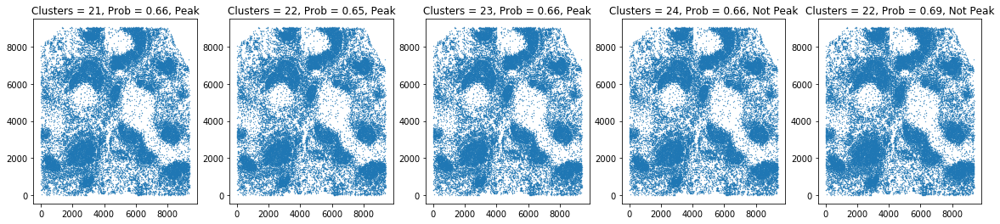

...

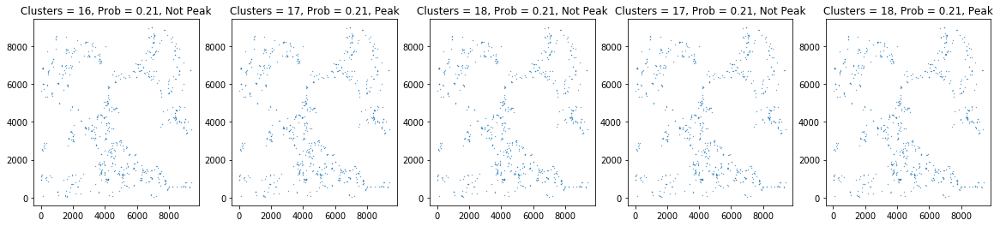

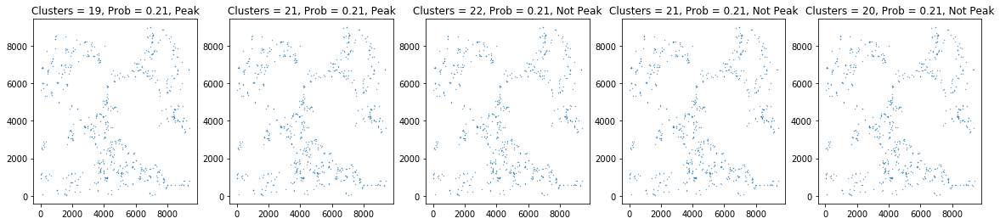

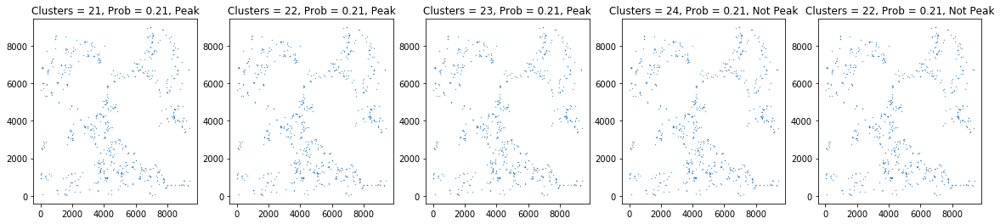

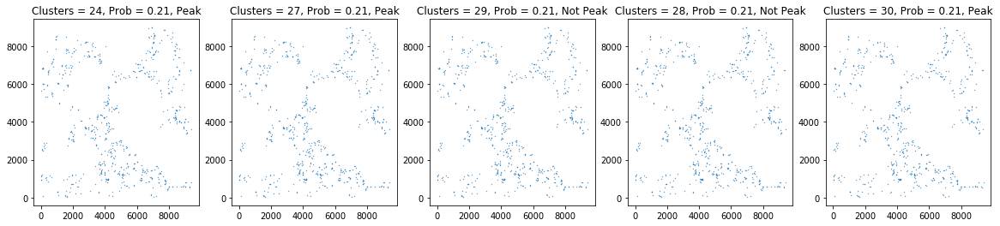

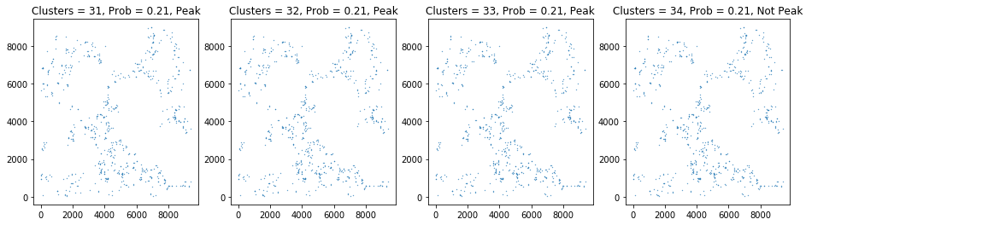

Plotting densest paths for cell line erythroblasts with ID 9613


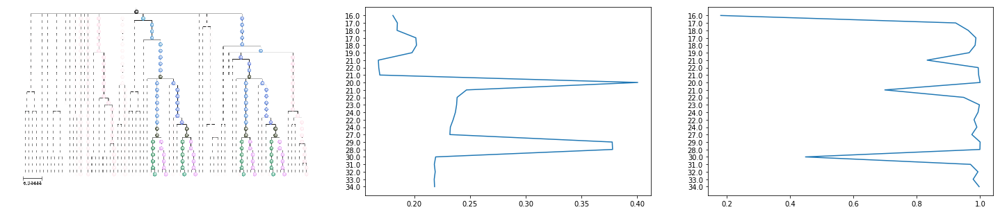

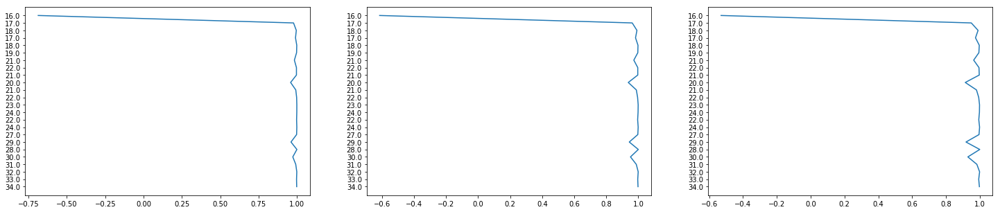

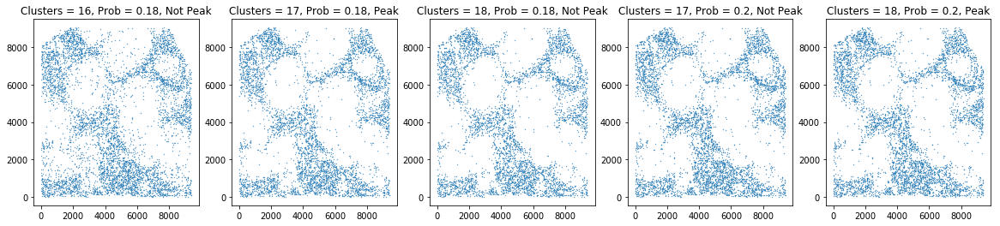

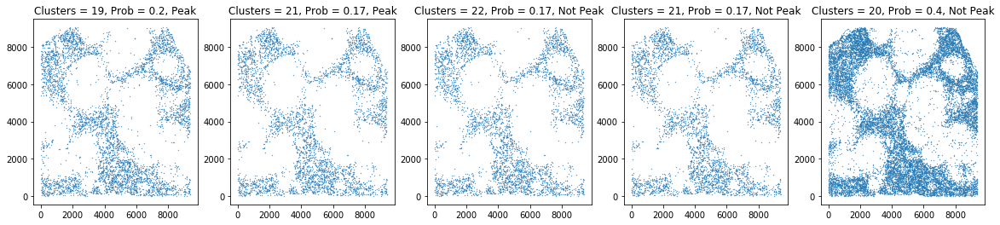

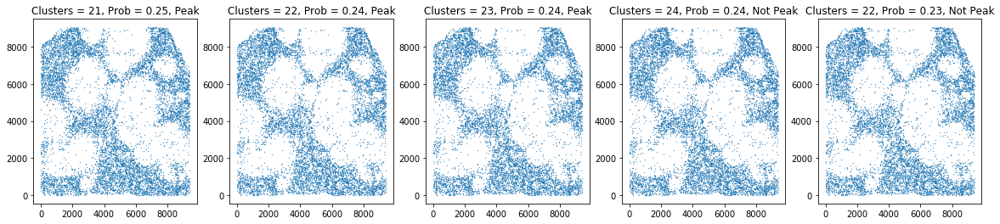

...

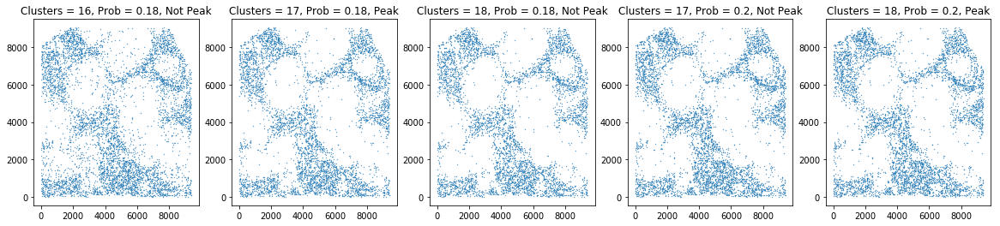

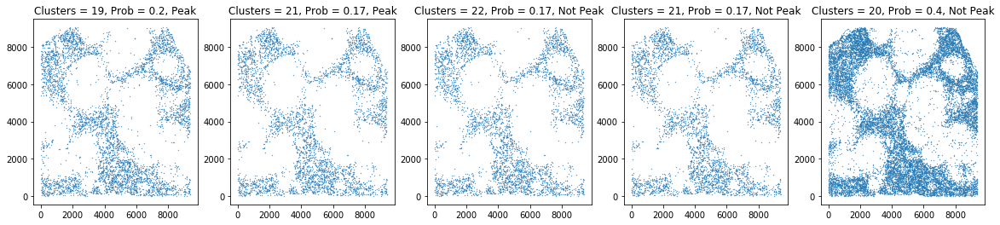

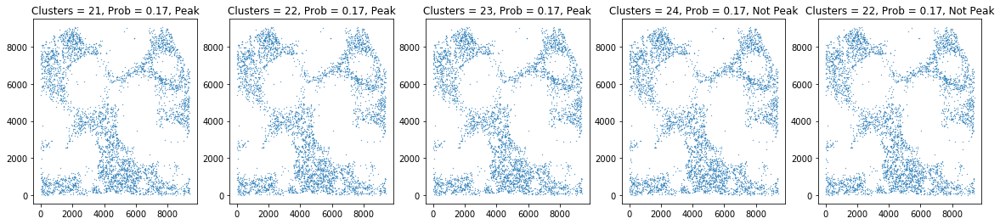

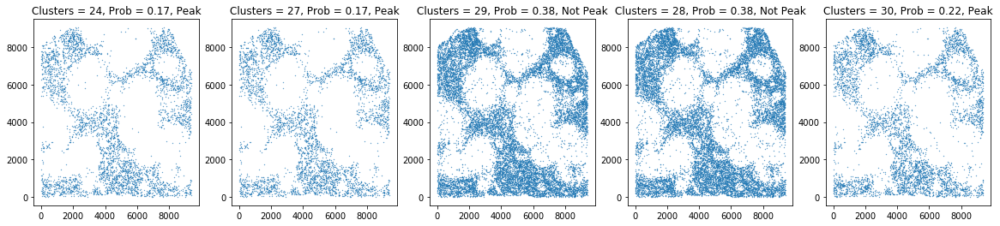

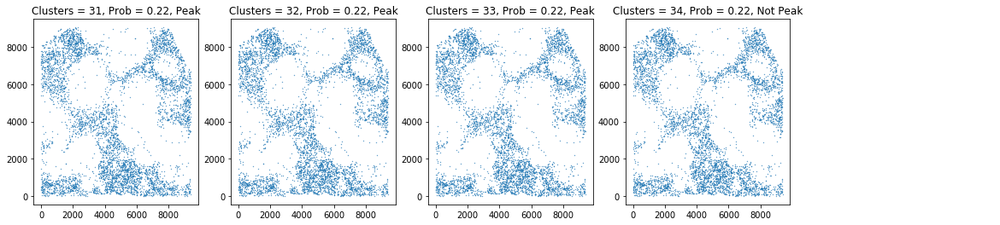

Plotting densest paths for cell line erythroblasts with ID 9618


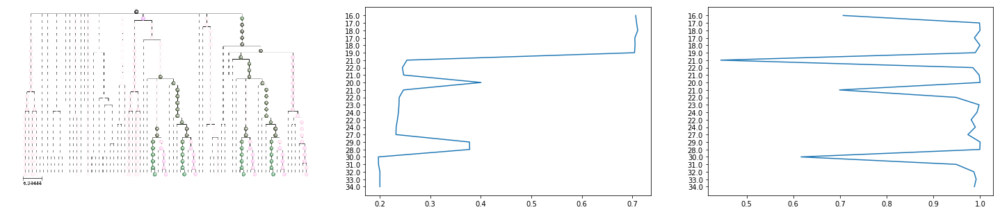

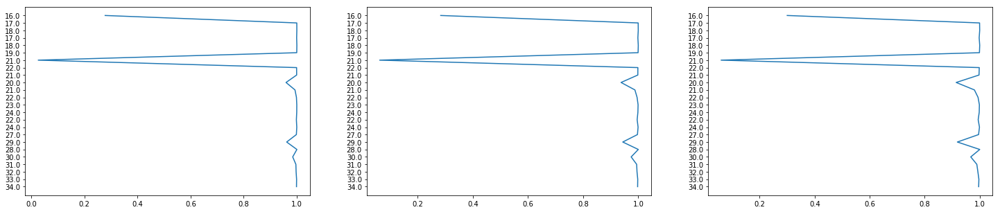

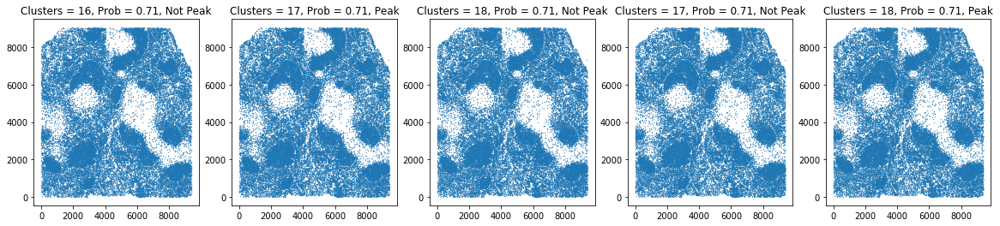

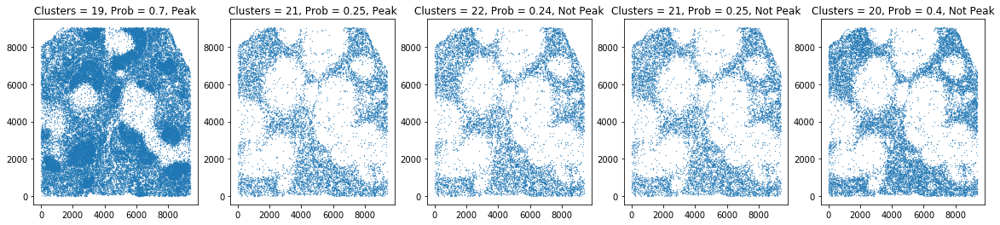

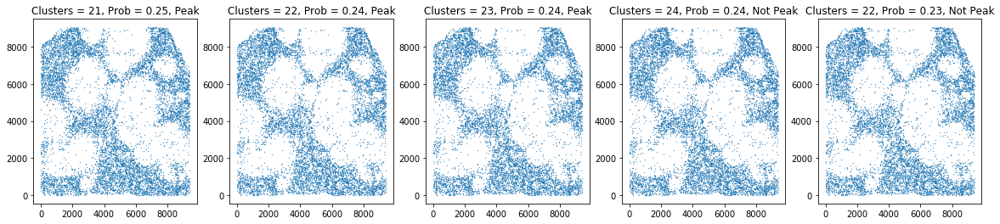

...

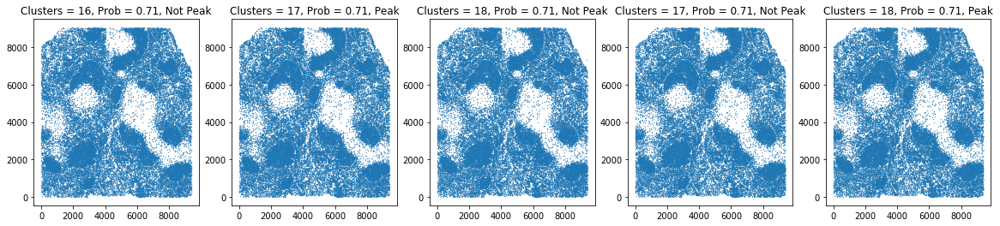

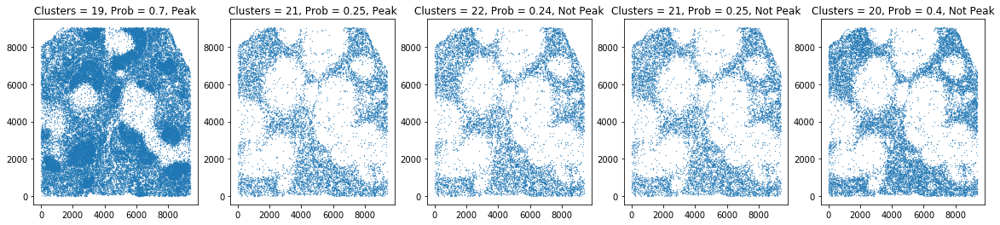

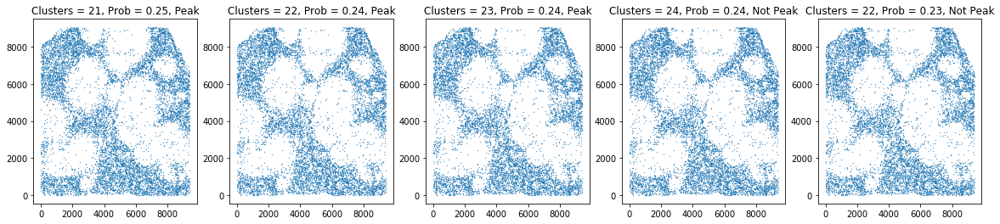

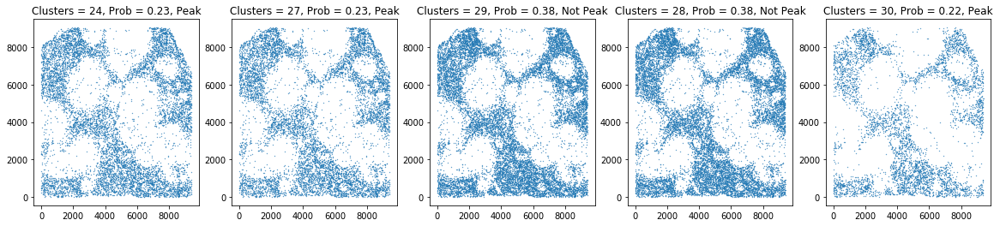

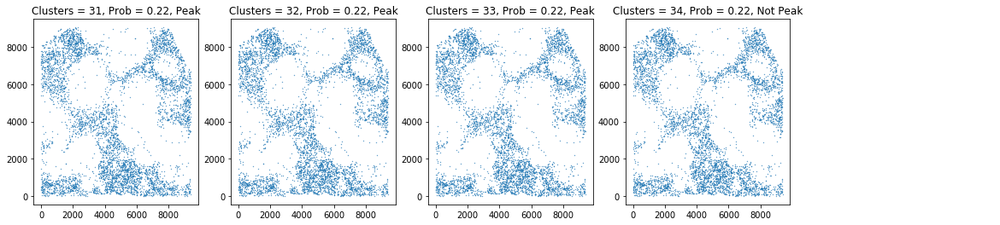

Plotting densest paths for cell line erythroblasts with ID 9607


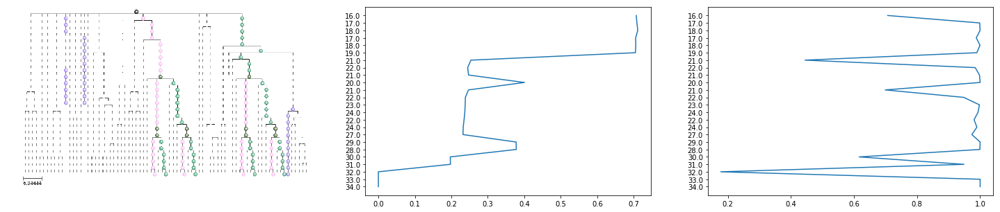

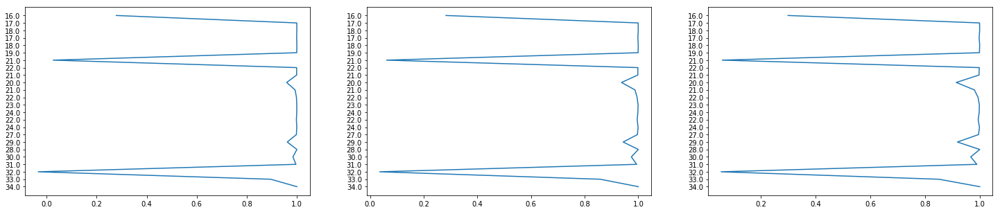

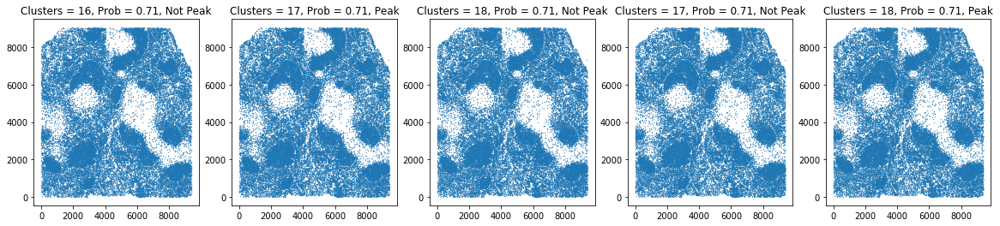

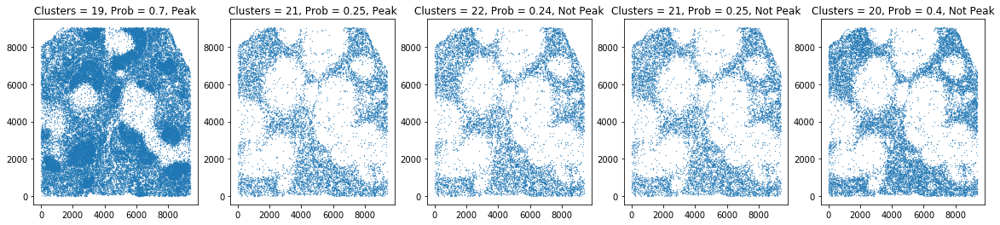

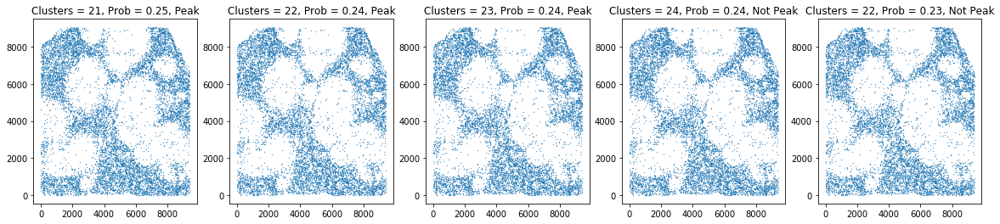

...

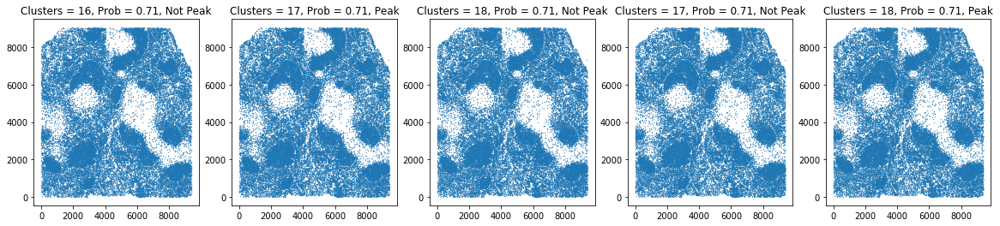

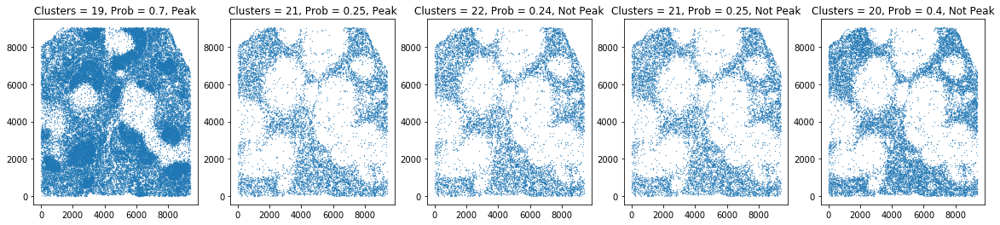

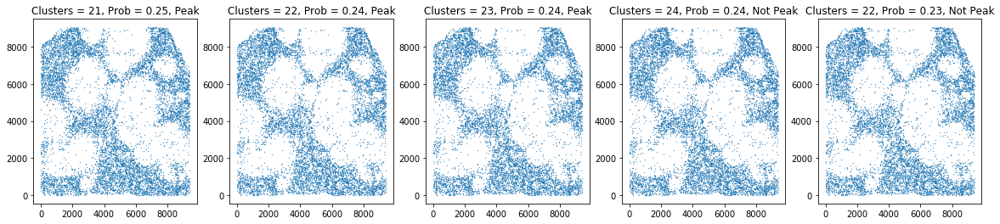

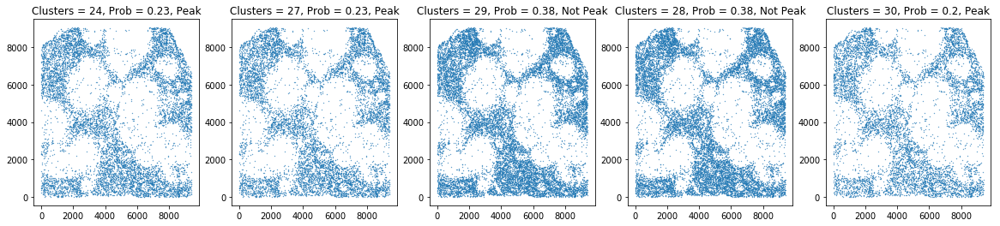

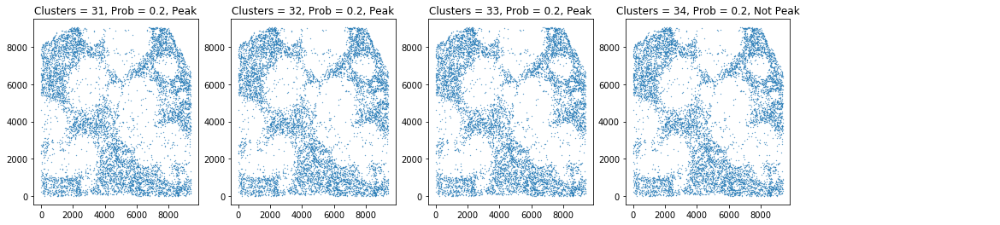

Plotting densest paths for cell line capsule with ID 9601


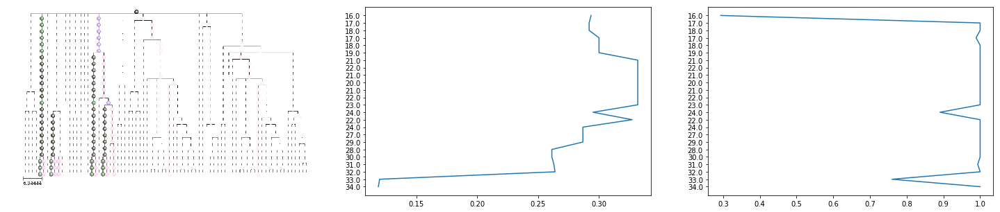

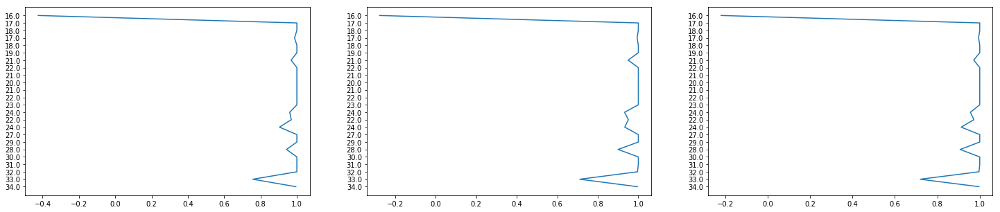

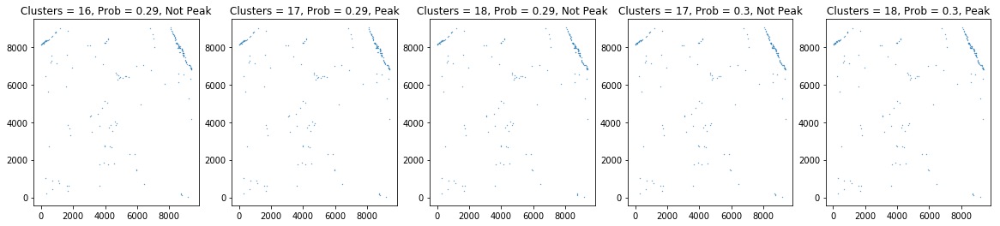

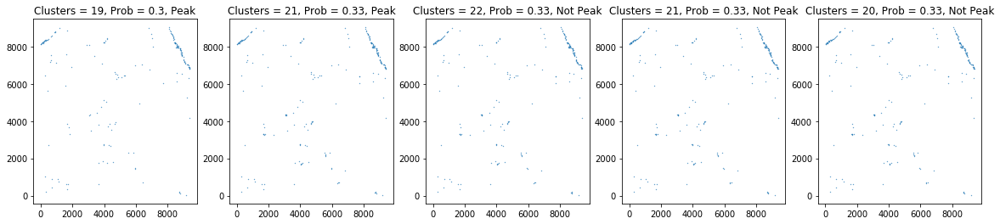

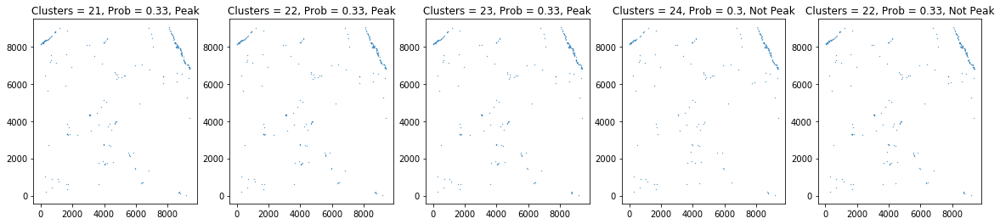

...

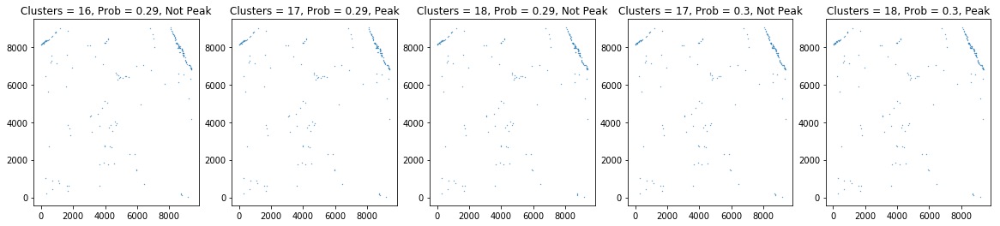

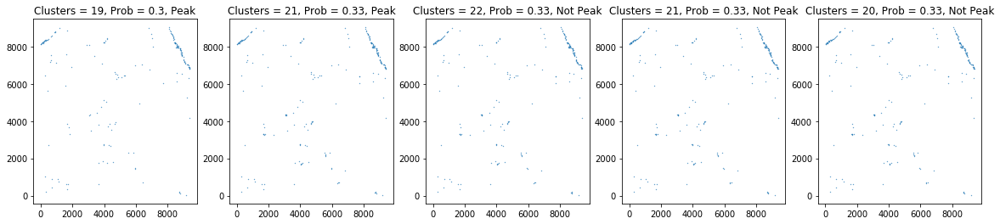

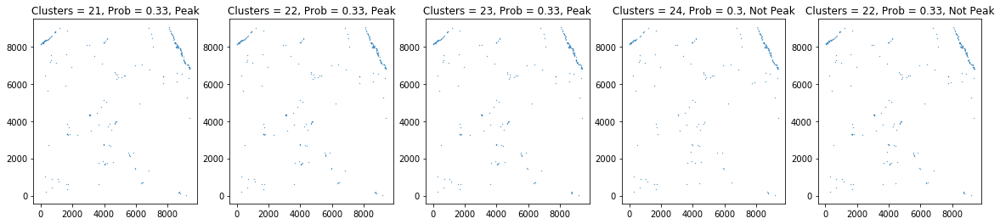

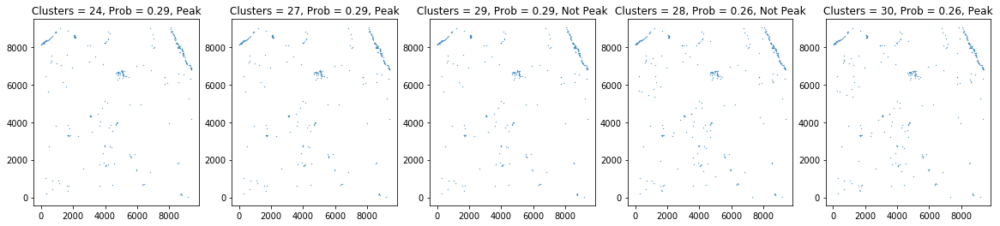

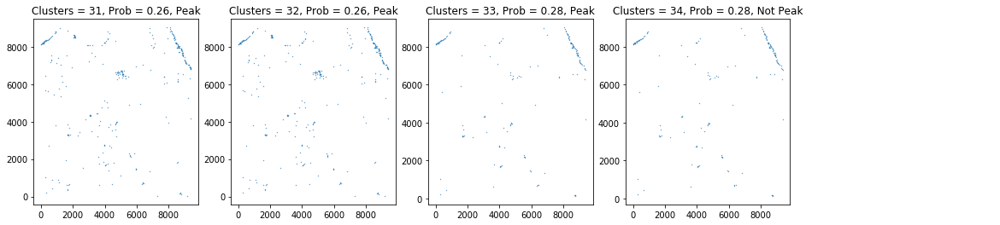

Plotting densest paths for cell line CD4(+)MHCII(+) with ID 9628


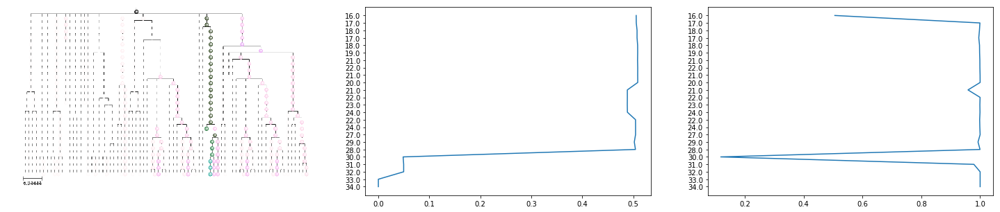

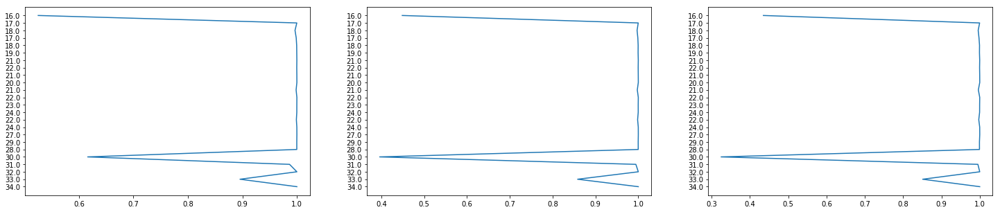

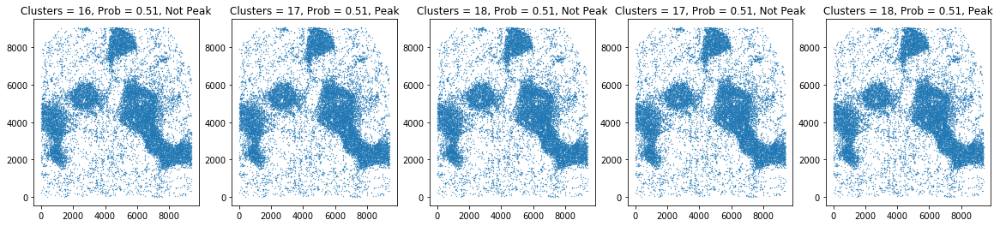

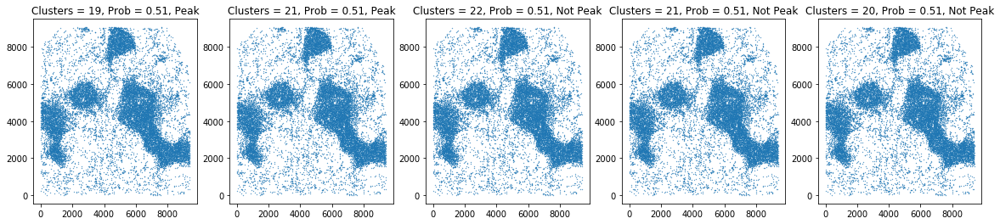

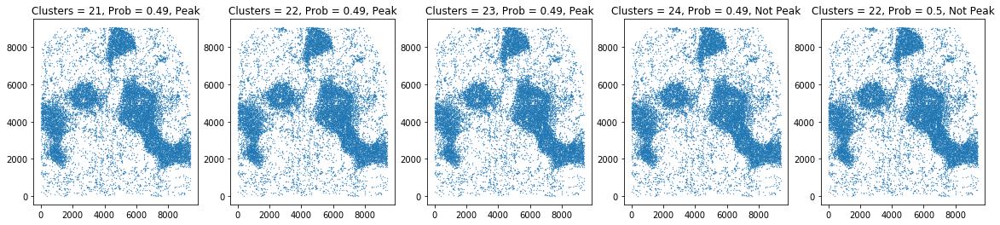

...

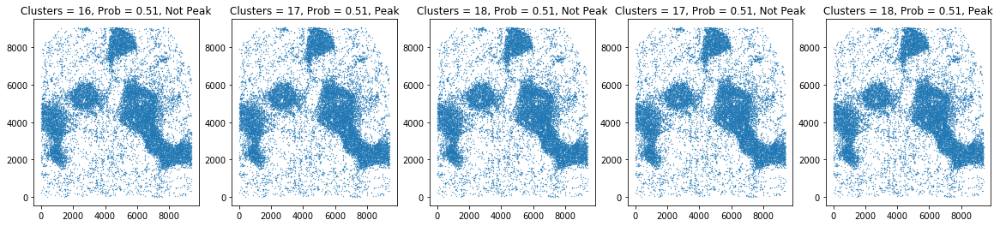

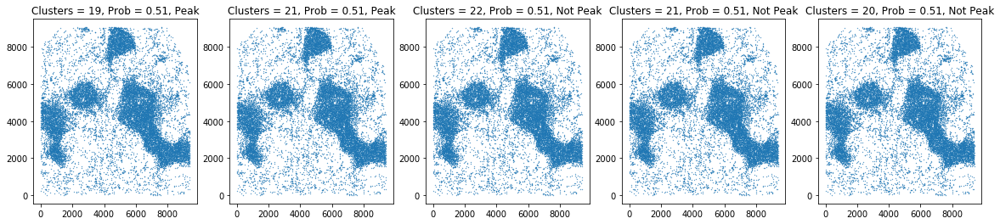

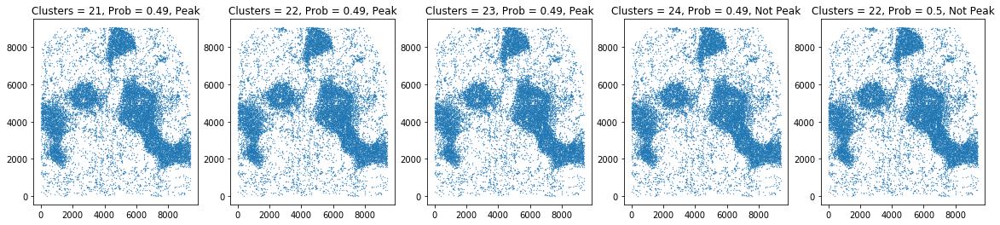

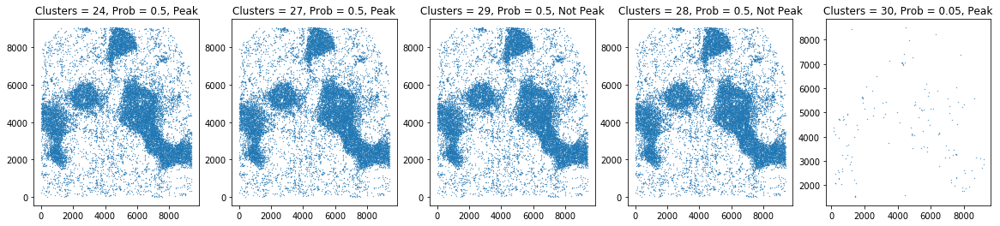

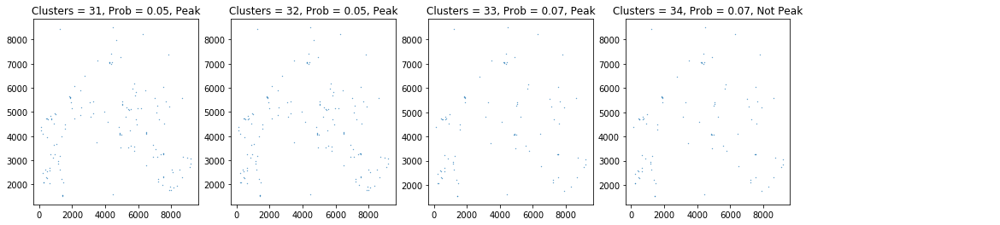

Plotting densest paths for cell line NK cells with ID 9592


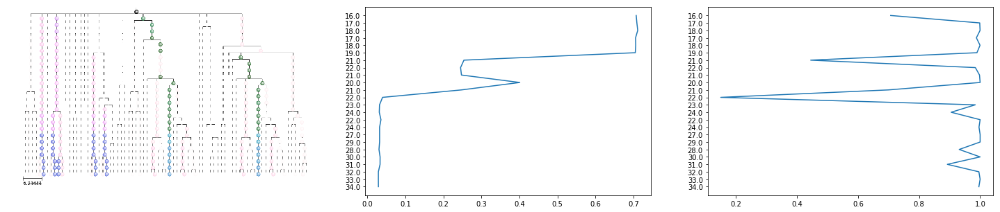

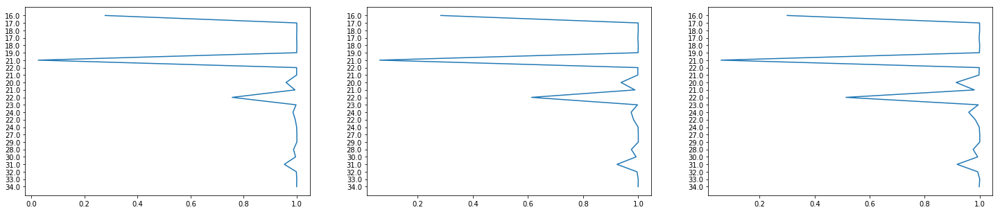

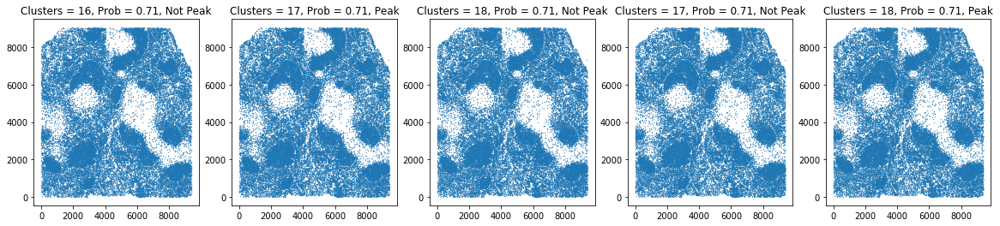

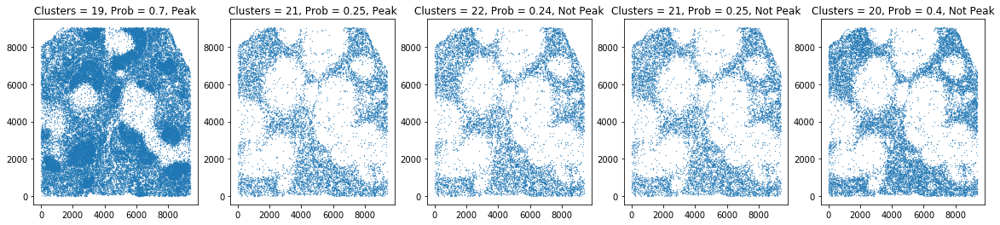

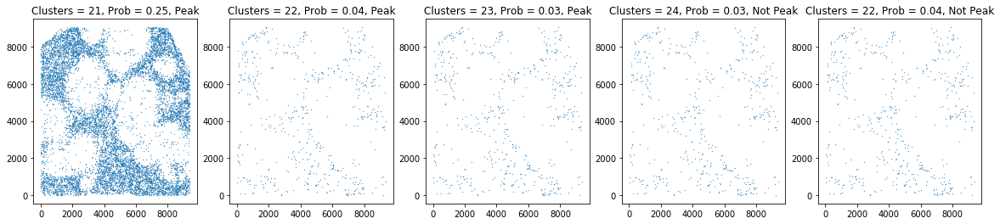

...

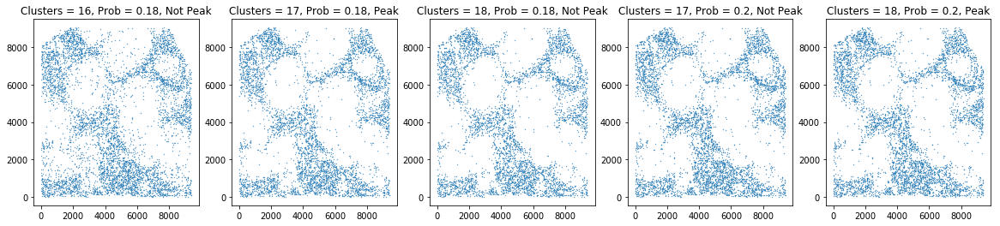

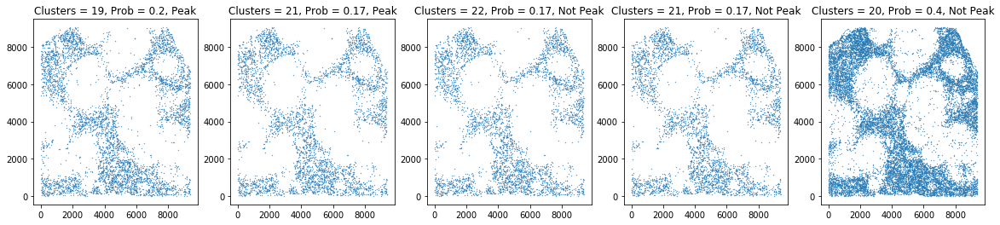

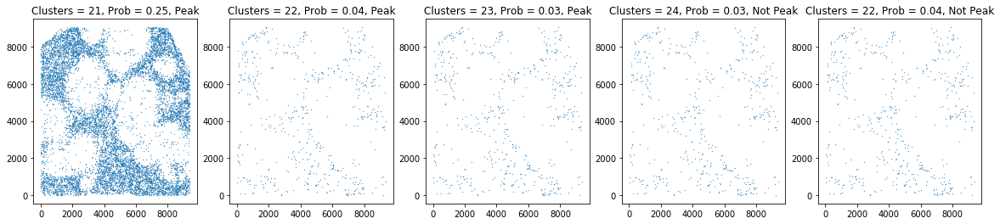

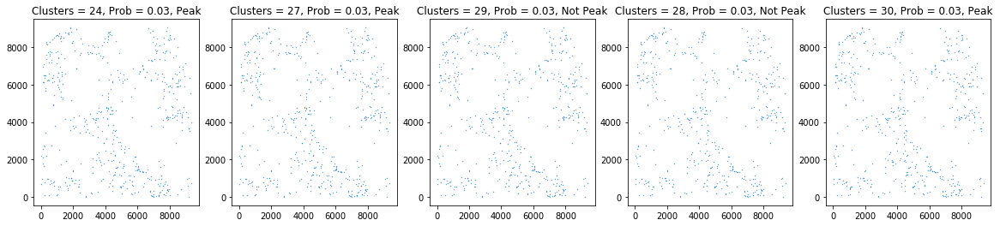

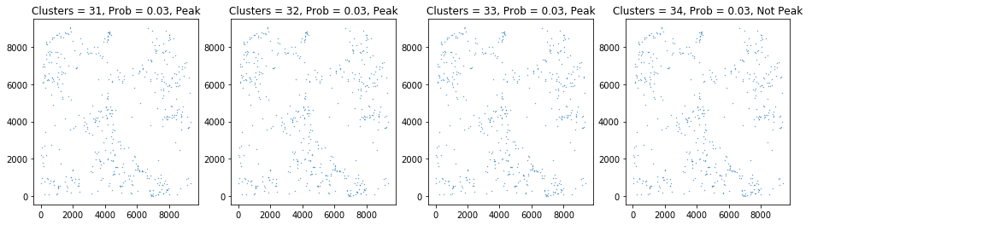

Plotting densest paths for cell line NK cells with ID 9587


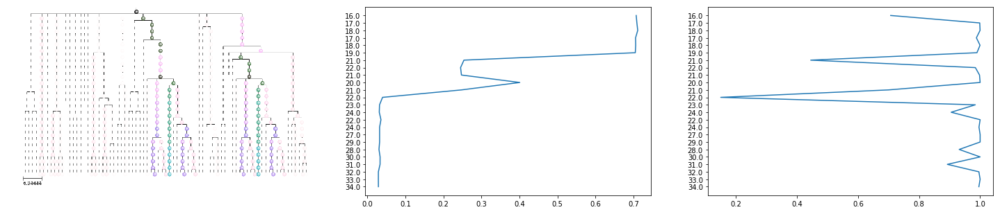

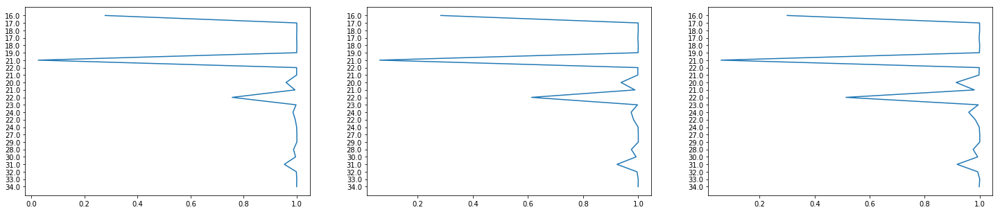

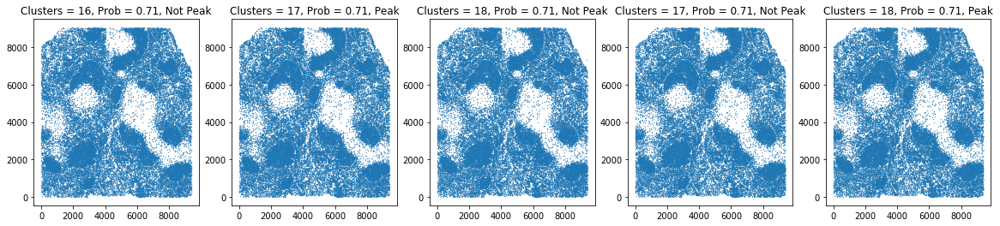

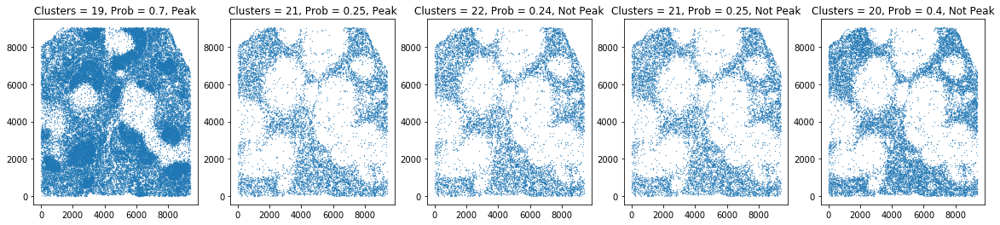

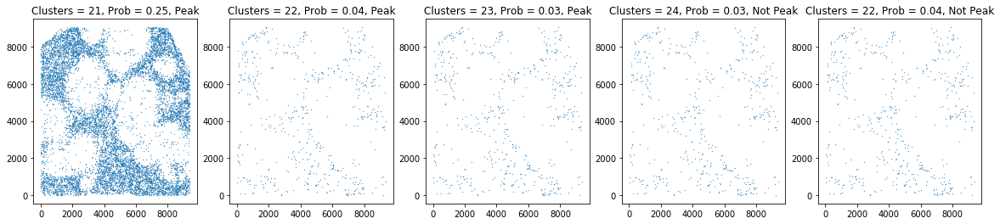

...

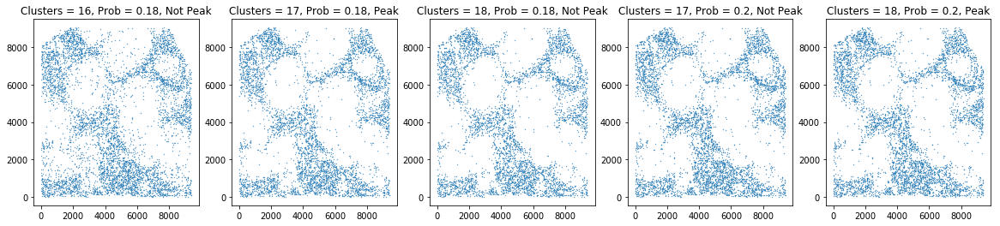

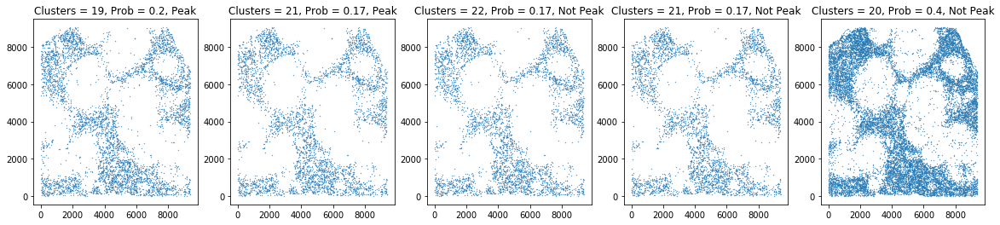

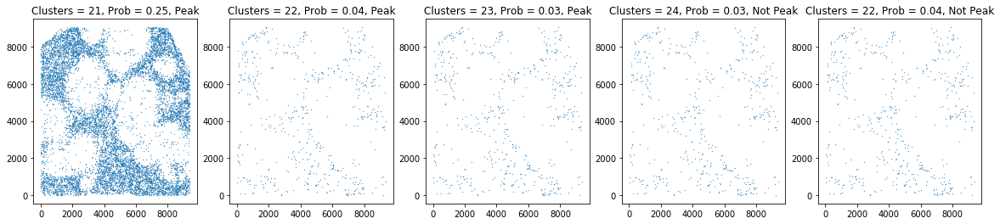

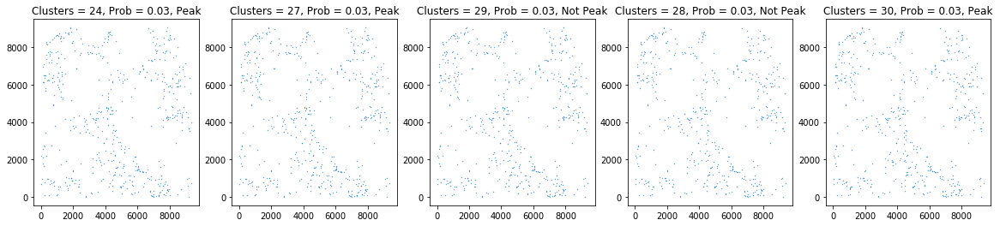

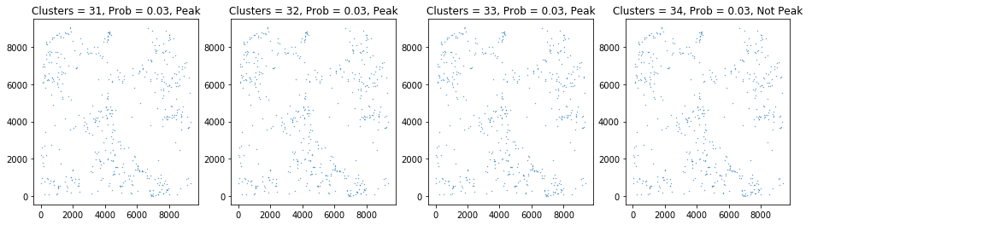

Plotting densest paths for cell line FDCs with ID 9597


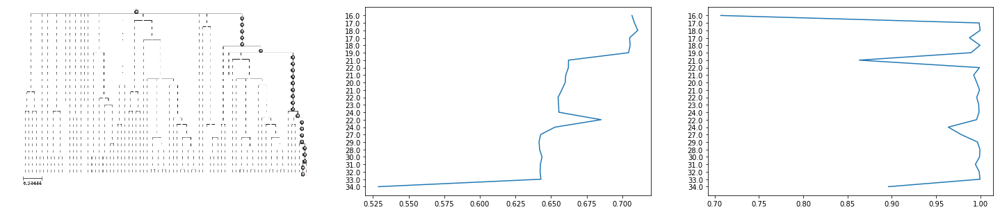

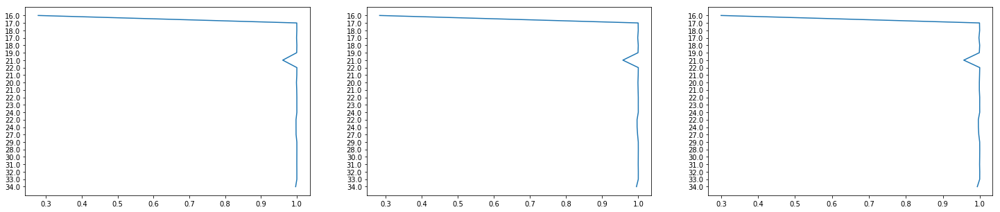

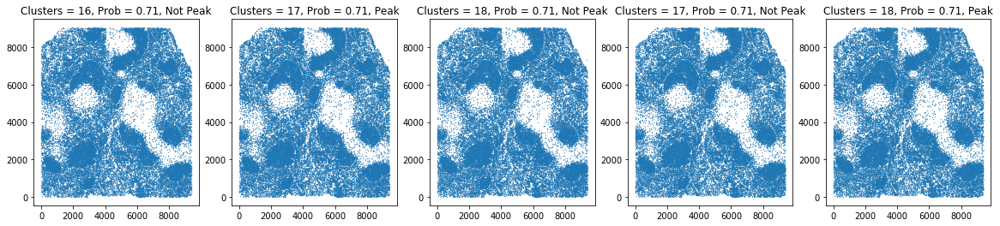

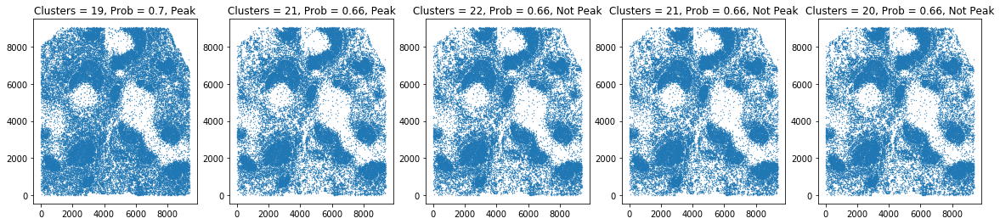

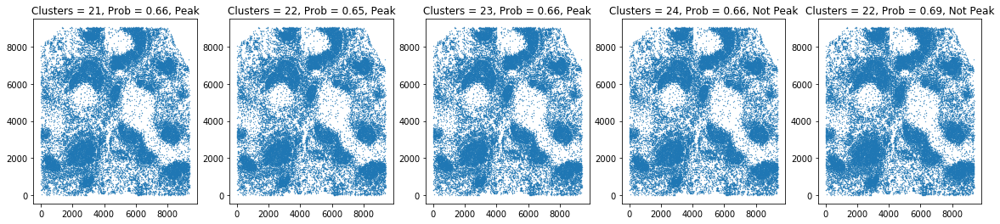

...

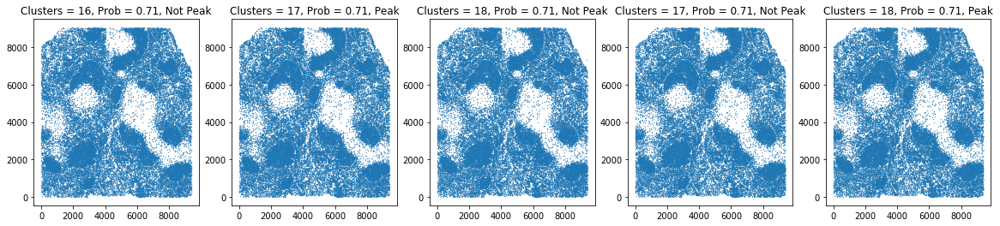

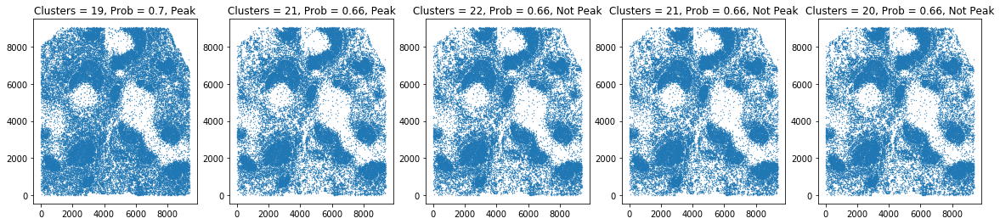

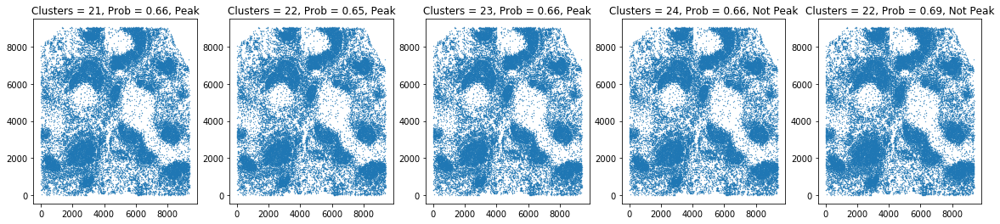

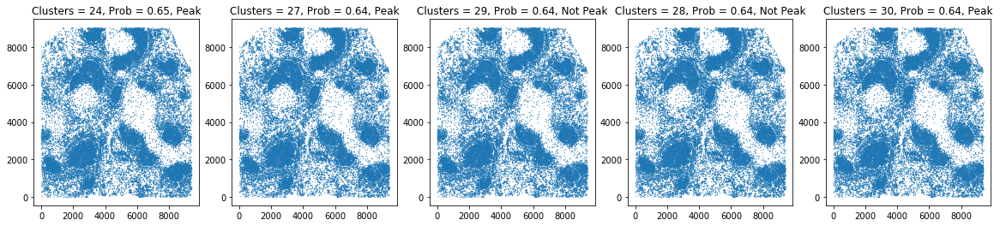

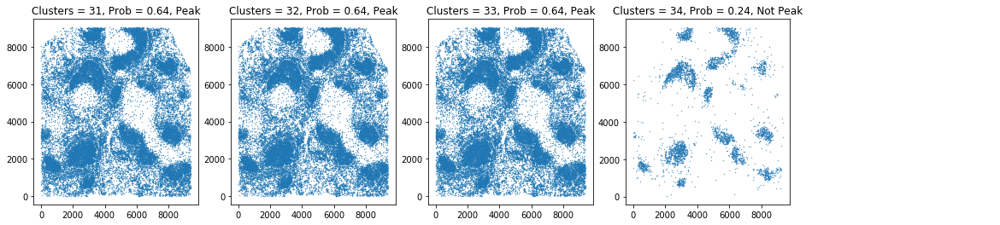

Plotting densest paths for cell line F4/80(+) mphs with ID 9596


FileNotFoundError: [Errno 2] No such file or directory: 'cell_line_F4/80(+) mphs_9596.png'

In [16]:
for line in cell_lines:
    name = ids_to_names[line]
    plot_densest_cell_line_paths(line, name, num_layers=25, num_paths=2)

## Plot Cell Clusters for Optimal Number of Clusters

In [ ]:
def plot_clusters(sample_name = 'BALBc-1', num_clusters = 40):
    path = data_dir + '/' + sample_name + '/' + \
           str(num_clusters) + '/out/' + sample_name + '.fcs'
    _, data = fcsparser.parse(path)
    data = process_fcs(data)
    data = data[['X', 'Y', 'cluster_id']]
    plt.scatter(data['X'], data['Y'], c=data['cluster_id'], s=1)
    plt.show()

### K = 40

In [ ]:
plot_clusters('BALBc-1', 40)

### K = 45

In [ ]:
plot_clusters('BALBc-1', 45)

### K = 50

In [ ]:
plot_clusters('BALBc-1', 50)

### K = 55

In [ ]:
plot_clusters('BALBc-1', 55)

### K = 60

In [ ]:
plot_clusters('BALBc-1', 57)